# 1. Importing dependencies

In [1]:
!pip install ipython-autotime -q
%load_ext autotime

import sys, os
import zipfile
import time
import datetime
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import optuna
import sklearn
import tensorflow as tf
from tensorflow.keras.utils import load_img, img_to_array
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, Layer, Flatten, Input, Dropout
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, AdamW, SGD, RMSprop
from tensorflow.keras.applications import VGG19, EfficientNetV2B0, EfficientNetV2B1, EfficientNetV2B2, EfficientNetV2B3, EfficientNetV2S, EfficientNetV2M, EfficientNetV2L
from tensorflow.keras.applications.vgg19 import preprocess_input as vgg19_preprocess_input
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as efficientnetv2_preprocess_input
from tensorflow.keras.metrics import Accuracy, BinaryAccuracy, CategoricalAccuracy, SparseCategoricalAccuracy
from tensorflow.keras.losses import MeanSquaredError, BinaryCrossentropy, CategoricalCrossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau
from tensorflow.keras.utils import plot_model
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, auc, accuracy_score, f1_score

2024-08-06 11:14:01.355426: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-06 11:14:01.355574: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-06 11:14:01.493287: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


time: 13.3 s (started: 2024-08-06 11:13:58 +00:00)


In [2]:
print("-"*50)
print(f"Python Version\t:")
!python --version
print("-"*50)
print(f"Numpy Version\t\t: {np.__version__}")
print(f"Pandas Version\t\t: {pd.__version__}")
print(f"Tensorflow Version\t: {tf.__version__}")
print(f"Matplotlib Version\t: {matplotlib.__version__}")
print(f"Seaborn Version\t\t: {sns.__version__}")
print(f"Scikit-learn Version\t: {sklearn.__version__}")
print(f"Optuna Version\t\t: {optuna.__version__}")
print(f"GPU Accelerator\t\t: {tf.config.list_physical_devices('GPU')}")
print("-"*50)

--------------------------------------------------
Python Version	:


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Python 3.10.13
--------------------------------------------------
Numpy Version		: 1.26.4
Pandas Version		: 2.2.2
Tensorflow Version	: 2.15.0
Matplotlib Version	: 3.7.5
Seaborn Version		: 0.12.2
Scikit-learn Version	: 1.2.2
Optuna Version		: 3.6.1
GPU Accelerator		: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
--------------------------------------------------
time: 1.23 s (started: 2024-08-06 11:14:11 +00:00)


In [3]:
!nvidia-smi

Tue Aug  6 11:14:14 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.90.07              Driver Version: 550.90.07      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla P100-PCIE-16GB           Off |   00000000:00:04.0 Off |                    0 |
| N/A   38C    P0             25W /  250W |       3MiB /  16384MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# 2. Utils

## 2.1. Show Images

In [4]:
def show_images_from_generator(generator, num_images=5):
    sample_images, sample_labels = next(generator)

    fig, axes = plt.subplots(1, num_images, figsize=(20, 20))
    axes = axes.flatten()
    for img, label, ax in zip(sample_images[:num_images], sample_labels[:num_images], axes):
        ax.imshow(img)
        ax.set_title(f'Label: {label}')
        ax.axis('off')
    plt.tight_layout()
    plt.show()

time: 950 µs (started: 2024-08-06 11:14:14 +00:00)


## 2.2. EDA

In [5]:
def show_number_of_sample_train_test(train_set, valid_set, test_set):
    class_names = list(train_set.class_indices.keys())

    # Calculate class counts for train, valid, and test sets
    train_class_count = np.unique(train_set.classes, return_counts=True)
    valid_class_count = np.unique(valid_set.classes, return_counts=True)
    test_class_count = np.unique(test_set.classes, return_counts=True)

    # Sum train and validation counts
    total_train_valid_counts = train_class_count[1] + valid_class_count[1]

    plt.figure(figsize=(10, 5))

    # Combined Train + Validation Set
    plt.subplot(1, 2, 1)
    sns.barplot(x=class_names, y=total_train_valid_counts, palette=['mediumturquoise', 'orangered'])
    plt.title('Total Train + Validation Set')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    for index, value in enumerate(total_train_valid_counts):
        plt.text(index, value, str(value), ha='center', va='bottom')

    # Test Set
    plt.subplot(1, 2, 2)
    sns.barplot(x=class_names, y=test_class_count[1], palette=['mediumturquoise', 'orangered'])
    plt.title('Test Set')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    for index, value in enumerate(test_class_count[1]):
        plt.text(index, value, str(value), ha='center', va='bottom')

    plt.tight_layout()
    plt.show()


time: 2.51 ms (started: 2024-08-06 11:14:14 +00:00)


In [6]:
def show_number_of_sample(train_set, valid_set, test_set):
    class_names = list(train_set.class_indices.keys())

    train_class_count = np.unique(train_set.classes, return_counts=True)
    valid_class_count = np.unique(valid_set.classes, return_counts=True)
    test_class_count = np.unique(test_set.classes, return_counts=True)

    plt.figure(figsize=(15, 5))

    # Train Set
    plt.subplot(1, 3, 1)
    sns.barplot(x=class_names, y=train_class_count[1], palette=['mediumturquoise', 'orangered'])
    plt.title('Train Set')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    for index, value in enumerate(train_class_count[1]):
        plt.text(index, value, str(value), ha='center', va='bottom')

    # Validation Set
    plt.subplot(1, 3, 2)
    sns.barplot(x=class_names, y=valid_class_count[1], palette=['mediumturquoise', 'orangered'])
    plt.title('Validation Set')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    for index, value in enumerate(valid_class_count[1]):
        plt.text(index, value, str(value), ha='center', va='bottom')

    # Test Set
    plt.subplot(1, 3, 3)
    sns.barplot(x=class_names, y=test_class_count[1], palette=['mediumturquoise', 'orangered'])
    plt.title('Test Set')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    for index, value in enumerate(test_class_count[1]):
        plt.text(index, value, str(value), ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

time: 4.82 ms (started: 2024-08-06 11:14:14 +00:00)


In [7]:
def show_number_of_data_separation_train_test(train_set, valid_set, test_set):

    # Calculate the total number of samples in each set
    total_train_samples = len(train_set.labels)
    total_valid_samples = len(valid_set.labels)
    total_test_samples = len(test_set.labels)

    # Combine train and validation samples
    total_train_valid_samples = total_train_samples + total_valid_samples
    total_samples = total_train_valid_samples + total_test_samples

    # Calculate the percentages
    train_valid_percentage = (total_train_valid_samples / total_samples) * 100
    test_percentage = (total_test_samples / total_samples) * 100

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), gridspec_kw={'wspace': 0.4})

    # Pie chart
    labels = ['Train + Validation', 'Test']
    sizes = [train_valid_percentage, test_percentage]
    colors = ['gold', 'lightcoral']
    explode = (0.1, 0)  # explode 1st slice
    ax1.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
    ax1.axis('equal')
    ax1.set_title('\nPercentage of Data Samples\n')

    # Bar chart
    categories = ['Train + Validation', 'Test']
    counts = [total_train_valid_samples, total_test_samples]
    bars = ax2.bar(categories, counts, color=colors)
    ax2.set_ylabel('Number of Samples')
    ax2.set_title('\nNumber of Samples in Each Set\n')

    for bar, count in zip(bars, counts):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width() / 2, height, count, ha='center', va='bottom')

    plt.tight_layout()
    plt.show()


time: 5.49 ms (started: 2024-08-06 11:14:14 +00:00)


In [8]:
def show_number_of_data_separation(train_set, valid_set, test_set):

    total_train_samples = len(train_set.labels)
    total_valid_samples = len(valid_set.labels)
    total_test_samples = len(test_set.labels)

    total_samples = total_train_samples + total_valid_samples + total_test_samples

    train_percentage = (total_train_samples / total_samples) * 100
    valid_percentage = (total_valid_samples / total_samples) * 100
    test_percentage = (total_test_samples / total_samples) * 100

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), gridspec_kw={'wspace': 0.4})

    labels = ['Train', 'Validation', 'Test']
    sizes = [train_percentage, valid_percentage, test_percentage]
    colors = ['gold', 'yellowgreen', 'lightcoral']
    explode = (0.1, 0, 0)  # explode 1st slice
    ax1.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
    ax1.axis('equal')
    ax1.set_title('\nPersentase Jumlah Data\n')

    categories = ['Train', 'Validation', 'Test']
    counts = [total_train_samples, total_valid_samples, total_test_samples]
    bars = ax2.bar(categories, counts, color=colors)
    ax2.set_ylabel('Jumlah Data')
    ax2.set_title('\nJumlah Data dalam Setiap Kategori\n')

    for bar, count in zip(bars, counts):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width() / 2, height, count, ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

time: 6.13 ms (started: 2024-08-06 11:14:14 +00:00)


In [9]:
def count_datasets(dir_path):
    img_count_author_asli = 0
    img_count_author_palsu = 0
    img_count_external_asli = 0
    img_count_external_palsu = 0

    for dirpath, dirnames, filenames in os.walk(dir_path):
        if 'Asli' in dirpath:
            for filename in filenames:
                if filename.startswith("IMG_"):
                    img_count_author_asli += 1
                else:
                    img_count_external_asli += 1
        elif 'Palsu' in dirpath:
            for filename in filenames:
                if filename.startswith("IMG_"):
                    img_count_author_palsu += 1
                else:
                    img_count_external_palsu += 1

    return img_count_author_asli, img_count_author_palsu, img_count_external_asli, img_count_external_palsu

def show_count_datasets(dir_path):
    author_asli, author_palsu, external_asli, external_palsu = count_datasets(dir_path)

    labels = ['Hasil Pemotretan Penulis', 'Sumber Eksternal']
    counts_asli = [author_asli, external_asli]
    counts_palsu = [author_palsu, external_palsu]

    x = range(len(labels))
    bar_width = 0.35

    plt.bar(x, counts_asli, width=bar_width, label='Asli', color='mediumturquoise', align='center')
    plt.bar([i + bar_width for i in x], counts_palsu, width=bar_width, label='Palsu', color='orangered', align='center')

    for i, v in enumerate(counts_asli):
        plt.text(i - 0.1, v + 5, str(v), color='black')

    for i, v in enumerate(counts_palsu):
        plt.text(i + bar_width - 0.1, v + 5, str(v), color='black')

    plt.xlabel('Sumber Dataset')
    plt.ylabel('Jumlah Gambar')
    plt.title('Perbandingan Jumlah Dataset')
    plt.xticks([i + bar_width / 2 for i in x], labels)
    plt.legend()
    plt.show()

time: 5.93 ms (started: 2024-08-06 11:14:14 +00:00)


## 2.3. Callbacks Preparation

In [10]:
def callbacks_list(monitor='val_loss', model_save_pathname='best_model.keras', early_stopping_patience=5, learning_rate_patience=3, learning_rate_scheme=0):
    '''TensorBoard'''
    # log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    # tb_callbacks = TensorBoard(log_dir=log_folder)
    logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
    tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

    '''EarlyStoping'''
    cnn_es_callback = EarlyStopping(monitor=monitor, min_delta=0, patience=early_stopping_patience, verbose=1)

    '''ModelCheckPoint'''
    cnn_mpt_callback = ModelCheckpoint(filepath=model_save_pathname, monitor=monitor, mode='auto', save_best_only=True, verbose=1)

    '''LearningRateScheduler'''
    def learning_rate_schedule(epoch, lr):
        if epoch < 10:
            return lr
        else:
            return float(lr * tf.math.exp(-0.1))

    lr_scheduler = LearningRateScheduler(learning_rate_schedule, verbose=1)

    '''ReduceLROnPlateau'''
    lr_reduction = ReduceLROnPlateau(monitor=monitor, factor=0.5, patience=learning_rate_patience, min_lr=1e-8, verbose=1)

    '''ReturnCallbacks'''
    if learning_rate_scheme == 0:
        callbacks = [cnn_es_callback, cnn_mpt_callback]
    elif learning_rate_scheme == 1:
        callbacks = [cnn_es_callback, cnn_mpt_callback, lr_scheduler]
    elif learning_rate_scheme == 2:
        callbacks = [cnn_es_callback, cnn_mpt_callback, lr_reduction]
    else:
        callbacks = []
        print('The value for learning_rate_scheme is only 0, 1, or 2.')

    return callbacks

time: 8.28 ms (started: 2024-08-06 11:14:14 +00:00)


## 2.4. Evaluation Preparation

In [11]:
class History():
    def __init__(self, history, model_name='MODEL'):
        self.history = history
        self.model_name = model_name

    def plot_accuracy_and_lost(self):
        history = self.history

        fig, axs = plt.subplots(1, 2, figsize=(10, 5))

        axs[0].plot(history.history['accuracy'], linestyle='--', label='accuracy')
        axs[0].plot(history.history['val_accuracy'], linestyle='-.', label='val_accuracy', )
        axs[0].set_title(f"\n{self.model_name} Accuracy\n")
        axs[0].set_xlabel('Epochs')
        axs[0].set_ylabel('Accuracy')
        axs[0].legend()

        axs[1].plot(history.history['loss'], linestyle='--', label='loss')
        axs[1].plot(history.history['val_loss'], linestyle='-.', label='val_loss', )
        axs[1].set_title(f"\n{self.model_name} Loss\n")
        axs[1].set_xlabel('Epochs')
        axs[1].set_ylabel('Loss')
        axs[1].legend()

        plt.tight_layout()
        plt.show()

    def plot_learningrate(self):
        history = self.history

        plt.plot(history.history['learning_rate'], color='orangered', linestyle='--', marker='o', label='learning_rate')
        plt.xlabel('Epoch')
        plt.ylabel('Learning Rate')
        plt.title(f'\n{self.model_name} Learning Rate\n')
        plt.legend()
        plt.show()

time: 5.58 ms (started: 2024-08-06 11:14:14 +00:00)


In [12]:
class ModelEvaluation():
    def __init__(self, model, test_set, model_name='MODEL'):
        self.model = model
        self.test_set = test_set
        self.y_true = test_set.classes
        self.y_pred = model.predict(test_set)
        self.model_name = model_name

    def evaluate(self):
        return self.model.evaluate(self.test_set)
    
    def predict_test(self):
        return self.y_true, self.y_pred

    def confusion_matrix(self):
        y_true = self.y_true
        y_pred = self.y_pred
        y_pred_classes = np.argmax(y_pred, axis=1)
        conf_matrix = confusion_matrix(y_true, y_pred_classes)
        return conf_matrix

    def classification_report(self):
        y_true = self.y_true
        y_pred = self.y_pred
        y_pred_classes = np.argmax(y_pred, axis=1)
        target_names = list(self.test_set.class_indices.keys())
        print(f"{self.model_name} Classification Report")
        print(classification_report(y_true, y_pred_classes, target_names=target_names))

    def roc_auc(self):
        y_true = self.y_true
        y_pred = self.y_pred
        roc_auc = {}
        target_names = list(self.test_set.class_indices.keys())
        for i in range(len(target_names)):
            roc_auc[target_names[i]] = roc_auc_score((y_true == i).astype(int), y_pred[:, i])
        return roc_auc

    def plot_confusion_matrix(self):
        conf_matrix = self.confusion_matrix()
        labels = list(self.test_set.class_indices.keys())
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='magma', xticklabels=labels, yticklabels=labels)
        plt.xlabel('Predicted labels')
        plt.ylabel('True labels')
        plt.title(f'{self.model_name} Confusion Matrix')
        plt.show()

    def plot_roc_auc(self):
        y_true = self.y_true
        y_pred = self.y_pred
        n_classes = len(np.unique(y_true))

        fpr, tpr, _ = roc_curve(y_true == 0, y_pred[:, 0])
        roc_auc = auc(fpr, tpr)

        plt.figure(figsize=(8, 6))
        lw = 2
        plt.plot(fpr, tpr, lw=lw, label='ROC class "{}" (AUC area = {:.2f})'.format(list(self.test_set.class_indices.keys())[0], roc_auc))
        plt.fill_between(fpr, tpr, color='orange', alpha=0.3)
        plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'{self.model_name} ROC Curve')
        plt.legend(loc="lower right")
        plt.show()

time: 2.8 ms (started: 2024-08-06 11:14:14 +00:00)


In [13]:
def history_to_dataframe(history, filename='model'):
    
    df = pd.DataFrame(history.history)
    
    val_loss_min = df['val_loss'].min()
    val_loss_epoch = df['val_loss'].idxmin()
    
    train_loss_min = df['loss'].min()
    train_loss_epoch = df['loss'].idxmin()
    
    print(f'Validation Loss Terendah: {val_loss_min:.4f} pada Epoch: {val_loss_epoch+1}')
    print(f'Training Loss Terendah: {train_loss_min:.4f} pada Epoch: {train_loss_epoch+1}')
    
    val_acc_max = df['val_accuracy'].max()
    val_acc_epoch = df['val_accuracy'].idxmax()
    
    train_acc_max = df['accuracy'].max()
    train_acc_epoch = df['accuracy'].idxmax()
    
    print(f'Validation Accuracy Tertinggi: {val_acc_max:.4f} pada Epoch: {val_acc_epoch+1}')
    print(f'Training Accuracy Tertinggi: {train_acc_max:.4f} pada Epoch: {train_acc_epoch+1}')
    
    df.to_csv(f'history_{filename}.csv', index=False)

    return df


time: 7.18 ms (started: 2024-08-06 11:14:14 +00:00)


## 2.5. Train and Calculate Model Execution Time

In [14]:
def train_model_with_callbacks(model, training_set, validation_set, epochs=1, batch_size=32, verbose='auto', callbacks=[]):
    print("="*50)
    print("\t\tSTART TRAINING")
    print("="*50+"\n")

    try:
        start_time = time.time()

        history = model.fit(
            training_set,
            validation_data=validation_set,
            epochs=epochs,
            batch_size=batch_size,
            verbose=verbose,
            callbacks=callbacks,
        )

        end_time = time.time()
    except tf.errors.ResourceExhaustedError as e:
        print()
        print("-"*50)
        print("Kesalahan: Resource Exhausted (GPU Kehabisan Memori)!!!")
        # print(e)
        print("-"*50)
    else:
        duration_seconds = end_time - start_time
        duration_minutes = duration_seconds // 60
        duration_seconds_modulo =  duration_seconds % 60
        duration_seconds_per_epoch = duration_seconds / len(history.history['learning_rate'])

        print()
        print("="*50)
        print("\t\tTRAINING COMPLETE")
        print("="*50)
        print(f"Total training Time:\n{int(duration_minutes)} minutes {int(duration_seconds_modulo)} seconds ({duration_seconds} total seconds).")
        print(f"Training Time Per Epoch:\n{duration_seconds_per_epoch:.2f}s/epoch")
        print(f"Total Epoch:\n{len(history.history['learning_rate'])}")
        print("="*50)

        return history

    print()
    print("="*50)
    print("\t\tTRAINING COMPLETE")
    print("="*50)

time: 4.57 ms (started: 2024-08-06 11:14:14 +00:00)


# 3. Config

In [15]:
class Config:
    IMAGE_SIZE = 256 # option: 256, 448, 512
    BATCH_SIZE = 64 # option: 32, 64
    SEED = 42 # default 42
    LABEL_MODE = 'categorical'
    VAL_SPLIT = 0.2 # option: 0.3, 0.2
    COLOR_MODE = 'rgb'
    CHANNEL = 3
    MONITOR = 'val_loss'
    LR = 1e-05 # best 1e-05
    LOSSES = CategoricalCrossentropy()
    METRICS = ['accuracy']
    ES_PATIENCE = 10 # mostly 15
    LR_PATIENCE = 5 # mostly 5
    LR_SCHEME = 2 # mostly 2
    EPOCH = 1000
    OUTPUT_LAYER = 2
    OUTPUT_ACTIVATION = 'softmax'

time: 9.9 ms (started: 2024-08-06 11:14:14 +00:00)


In [16]:
np.random.seed(Config.SEED)
tf.random.set_seed(Config.SEED)
# tf.config.experimental.enable_op_determinism()

time: 5.34 ms (started: 2024-08-06 11:14:14 +00:00)


# 4. Load Dataset

In [17]:
count = 0
for root, folders, filenames in os.walk('/kaggle/input'):
   print(root, folders)

/kaggle/input ['test', 'train']
/kaggle/input/test ['Asli', 'Palsu']
/kaggle/input/test/Asli []
/kaggle/input/test/Palsu []
/kaggle/input/train ['Asli', 'Palsu']
/kaggle/input/train/Asli []
/kaggle/input/train/Palsu []
time: 323 ms (started: 2024-08-06 11:14:14 +00:00)


In [18]:
dir_path = '/kaggle/input/'
train_set_dir = dir_path + '/train'
test_set_dir = dir_path + '/test'

for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"Terdapat {len(dirnames)} direktori and {len(filenames)} file gambar di '{dirpath}'.")

Terdapat 2 direktori and 0 file gambar di '/kaggle/input/'.
Terdapat 2 direktori and 0 file gambar di '/kaggle/input/test'.
Terdapat 0 direktori and 165 file gambar di '/kaggle/input/test/Asli'.
Terdapat 0 direktori and 53 file gambar di '/kaggle/input/test/Palsu'.
Terdapat 2 direktori and 0 file gambar di '/kaggle/input/train'.
Terdapat 0 direktori and 708 file gambar di '/kaggle/input/train/Asli'.
Terdapat 0 direktori and 162 file gambar di '/kaggle/input/train/Palsu'.
time: 7.05 ms (started: 2024-08-06 11:14:14 +00:00)


# 5. Dataset Generator (With Augment) and Visualization

In [19]:
train_datagen = ImageDataGenerator(
    rescale=1/255.,
#     rotation_range=180,
#     width_shift_range=0.01,
#     height_shift_range=0.01,
#     shear_range=0.05,
#     zoom_range=0.1,
#     horizontal_flip=False,
#     vertical_flip=False,
#     fill_mode='nearest',
    validation_split=Config.VAL_SPLIT,
)

valid_datagen = ImageDataGenerator(
    rescale=1/255.,
    validation_split=Config.VAL_SPLIT,
)

test_datagen = ImageDataGenerator(
    rescale=1./255.,
)

time: 1.53 ms (started: 2024-08-06 11:14:14 +00:00)


In [20]:
train_set = train_datagen.flow_from_directory(
    directory=train_set_dir,
    shuffle=True,
    target_size=(Config.IMAGE_SIZE, Config.IMAGE_SIZE),
    
    batch_size=Config.BATCH_SIZE,
    class_mode=Config.LABEL_MODE,
    color_mode=Config.COLOR_MODE,
    subset='training',
    seed=Config.SEED,
)

valid_set = valid_datagen.flow_from_directory(
    directory=train_set_dir,
    shuffle=True,
    target_size=(Config.IMAGE_SIZE, Config.IMAGE_SIZE),
    batch_size=Config.BATCH_SIZE,
    class_mode=Config.LABEL_MODE,
    subset='validation',
    color_mode=Config.COLOR_MODE,
    seed=Config.SEED,
)

test_set = test_datagen.flow_from_directory(
    directory=test_set_dir,
    shuffle=False,
    target_size=(Config.IMAGE_SIZE, Config.IMAGE_SIZE),
    batch_size=Config.BATCH_SIZE,
    class_mode=Config.LABEL_MODE,
)

Found 697 images belonging to 2 classes.
Found 173 images belonging to 2 classes.
Found 218 images belonging to 2 classes.
time: 49.5 ms (started: 2024-08-06 11:14:14 +00:00)


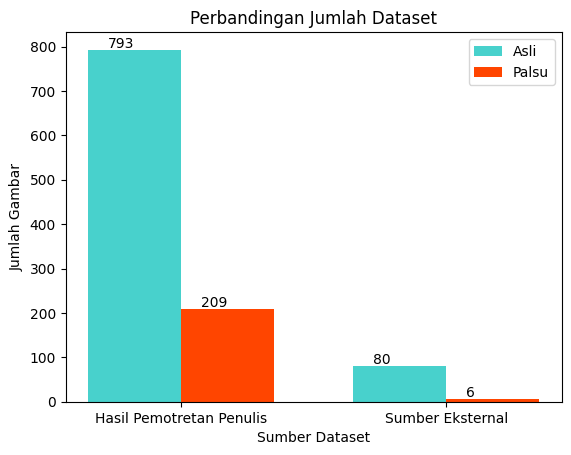

time: 317 ms (started: 2024-08-06 11:14:14 +00:00)


In [21]:
show_count_datasets(dir_path)

/tmp/ipykernel_34/1519368549.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


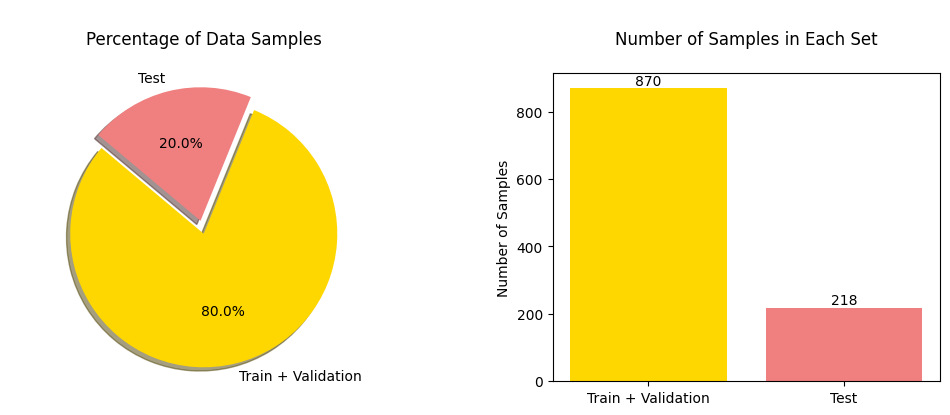

time: 344 ms (started: 2024-08-06 11:14:15 +00:00)


In [22]:
show_number_of_data_separation_train_test(train_set, valid_set, test_set)

In [23]:
# show_number_of_data_separation(train_set, valid_set, test_set)

time: 260 µs (started: 2024-08-06 11:14:15 +00:00)


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


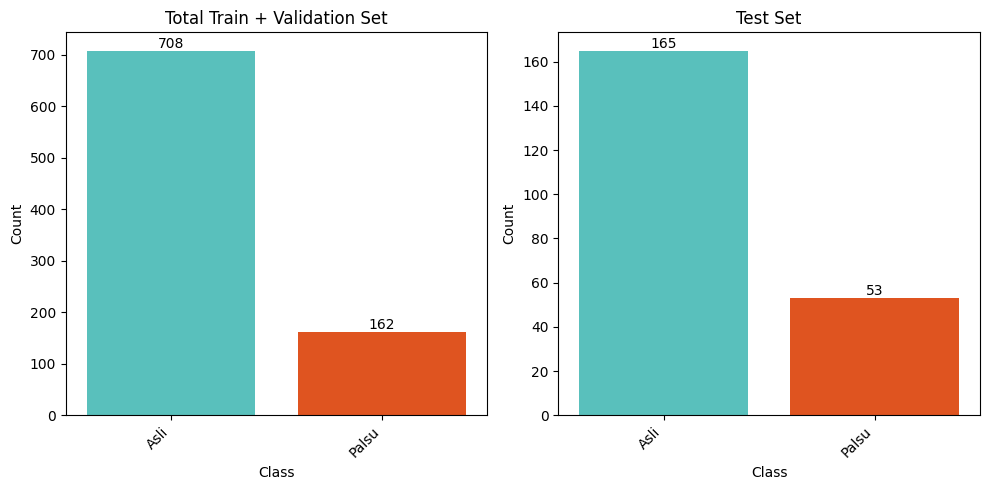

time: 510 ms (started: 2024-08-06 11:14:15 +00:00)


In [24]:
show_number_of_sample_train_test(train_set, valid_set, test_set)

In [25]:
# show_number_of_sample(train_set, valid_set, test_set)

time: 256 µs (started: 2024-08-06 11:14:15 +00:00)


In [26]:
test_set.class_indices

{'Asli': 0, 'Palsu': 1}

time: 9.9 ms (started: 2024-08-06 11:14:15 +00:00)


Train Set:


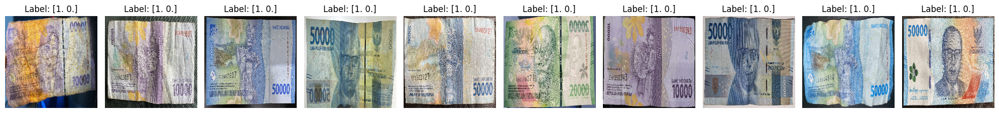

Validation Set:


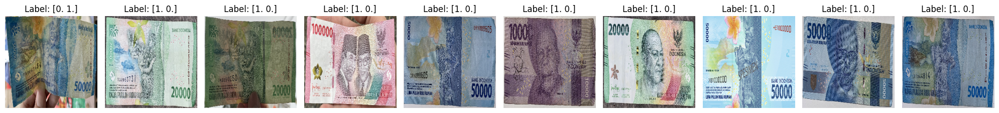

Test Set:


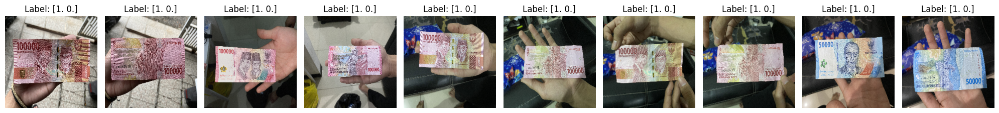

time: 11.5 s (started: 2024-08-06 11:14:15 +00:00)


In [27]:
print("Train Set:")
show_images_from_generator(train_set, num_images=10)

print("Validation Set:")
show_images_from_generator(valid_set, num_images=10)

print("Test Set:")
show_images_from_generator(test_set, num_images=10)

# 6. Building Models

## 6.1. Custom CNN

In [28]:
cnn_model = Sequential(name='custom_cnn_model')

cnn_model.add(Input(shape=(Config.IMAGE_SIZE, Config.IMAGE_SIZE, Config.CHANNEL)))

cnn_model.add(Conv2D(filters=32, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu'))
cnn_model.add(MaxPooling2D(pool_size=(2, 2), strides=None, padding='valid',))

cnn_model.add(Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu'))
cnn_model.add(MaxPooling2D(pool_size=(2, 2), strides=None, padding='valid',))

cnn_model.add(Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu'))
cnn_model.add(MaxPooling2D(pool_size=(2, 2), strides=None, padding='valid',))

cnn_model.add(Conv2D(filters=128, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu'))
cnn_model.add(MaxPooling2D(pool_size=(2, 2), strides=None, padding='valid',))

cnn_model.add(Conv2D(filters=128, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu'))
cnn_model.add(MaxPooling2D(pool_size=(2, 2), strides=None, padding='valid',))

cnn_model.add(Flatten())

cnn_model.add(Dense(512, activation='relu'))
cnn_model.add(Dropout(0.2))

cnn_model.add(Dense(units=Config.OUTPUT_LAYER, activation=Config.OUTPUT_ACTIVATION))

cnn_model.compile(
    loss=CategoricalCrossentropy(),
    optimizer=AdamW(learning_rate=Config.LR),
    metrics=['accuracy'],
)

cnn_model.summary(show_trainable=True)

Model: "custom_cnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ conv2d (Conv2D)             │ (None, 254, 254, 32)  │        896 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ max_pooling2d               │ (None, 127, 127, 32)  │          0 │   -   │
│ (MaxPooling2D)              │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ conv2d_1 (Conv2D)           │ (None, 125, 125, 64)  │     18,496 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ max_pooling2d_1             │ (None, 62, 62, 64)    │          0 │   -   │
│ (MaxPooling2D)              │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ conv2d_2 (Conv2D)           │ (None, 60, 60, 64)    │     36,928 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ max_pooling2d_2             │ (None, 30, 30, 64)    │          0 │   -   │
│ (MaxPooling2D)              │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ conv2d_3 (Conv2D)           │ (None, 28, 28, 128)   │     73,856 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ max_pooling2d_3             │ (None, 14, 14, 128)   │          0 │   -   │
│ (MaxPooling2D)              │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ conv2d_4 (Conv2D)           │ (None, 12, 12, 128)   │    147,584 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ max_pooling2d_4             │ (None, 6, 6, 128)     │          0 │   -   │
│ (MaxPooling2D)              │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ flatten (Flatten)           │ (None, 4608)          │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 2)             │      1,026 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 2,638,594 (10.07 MB)

 Trainable params: 2,638,594 (10.07 MB)

 Non-trainable params: 0 (0.00 B)

time: 658 ms (started: 2024-08-06 11:14:27 +00:00)


In [29]:
# plot_model(
#     cnn_model, 
#     show_shapes=True, 
#     show_dtype=False, 
#     show_layer_names=True,
#     rankdir="TB",
#     expand_nested=True,
#     dpi=96,
#     layer_range=None,
#     show_layer_activations=True,
#     show_trainable=True,
#     to_file='cnn_model.png'
#     )

time: 470 µs (started: 2024-08-06 11:14:28 +00:00)


## 6.2. VGG-19

In [30]:
vgg19_base_model = VGG19(
    include_top = False,
    weights = 'imagenet',
    input_shape = (Config.IMAGE_SIZE, Config.IMAGE_SIZE, Config.CHANNEL),
    pooling='avg',
)

vgg19_base_model.trainable = True

# x = GlobalAveragePooling2D()(efficientnetv2_base_model.output) # pooling = 'avg'
x = Dense(units=512, activation='relu')(vgg19_base_model.output)
# x = Dense(units=512, activation='relu')(x)
x = Dense(units=Config.OUTPUT_LAYER, activation=Config.OUTPUT_ACTIVATION)(x)

vgg19_model = Model(inputs=vgg19_base_model.input, outputs=x, name='vgg19_model')

vgg19_model.compile(
    loss=CategoricalCrossentropy(),
    optimizer=AdamW(learning_rate=Config.LR),
    metrics=['accuracy'],
)

vgg19_model.summary(show_trainable=True)

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "vgg19_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_1 (InputLayer)  │ (None, 256, 256, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv1 (Conv2D)       │ (None, 256, 256, 64)  │      1,792 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv2 (Conv2D)       │ (None, 256, 256, 64)  │     36,928 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_pool (MaxPooling2D)  │ (None, 128, 128, 64)  │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv1 (Conv2D)       │ (None, 128, 128, 128) │     73,856 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv2 (Conv2D)       │ (None, 128, 128, 128) │    147,584 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_pool (MaxPooling2D)  │ (None, 64, 64, 128)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv1 (Conv2D)       │ (None, 64, 64, 256)   │    295,168 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv2 (Conv2D)       │ (None, 64, 64, 256)   │    590,080 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv3 (Conv2D)       │ (None, 64, 64, 256)   │    590,080 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv4 (Conv2D)       │ (None, 64, 64, 256)   │    590,080 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_pool (MaxPooling2D)  │ (None, 32, 32, 256)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv1 (Conv2D)       │ (None, 32, 32, 512)   │  1,180,160 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv2 (Conv2D)       │ (None, 32, 32, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv3 (Conv2D)       │ (None, 32, 32, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv4 (Conv2D)       │ (None, 32, 32, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_pool (MaxPooling2D)  │ (None, 16, 16, 512)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv1 (Conv2D)       │ (None, 16, 16, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv2 (Conv2D)       │ (None, 16, 16, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv3 (Conv2D)       │ (None, 16, 16, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv4 (Conv2D)       │ (None, 16, 16, 512)   │  2,359,808 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_pool (MaxPooling2D)  │ (None, 8, 8, 512)     │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 512)           │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_2 (Dense)             │ (None, 512)           │    262,656 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼─────

 Total params: 20,288,066 (77.39 MB)

 Trainable params: 20,288,066 (77.39 MB)

 Non-trainable params: 0 (0.00 B)

time: 1.1 s (started: 2024-08-06 11:14:28 +00:00)


In [31]:
# plot_model(
#     vgg19_model, 
#     show_shapes=True, 
#     show_dtype=False, 
#     show_layer_names=True,
#     rankdir="TB",
#     expand_nested=True,
#     dpi=96,
#     layer_range=None,
#     show_layer_activations=True,
#     show_trainable=True,
#     to_file='vgg19_model.png'
#     )

time: 434 µs (started: 2024-08-06 11:14:29 +00:00)


## 6.3. EficientNetV2B2

In [32]:
efficientnetv2b2_base_model = EfficientNetV2B2(
    include_top = False,
    weights = 'imagenet',
    input_shape = (Config.IMAGE_SIZE, Config.IMAGE_SIZE, Config.CHANNEL),
    pooling='avg',
)

efficientnetv2b2_base_model.trainable = True

# x = GlobalAveragePooling2D()(efficientnetv2_base_model.output) # pooling = 'avg'
x = Dense(units=512, activation='relu')(efficientnetv2b2_base_model.output)
# x = Dense(units=512, activation='relu')(x)
x = Dense(units=Config.OUTPUT_LAYER, activation=Config.OUTPUT_ACTIVATION)(x)

efficientnetv2b2_model = Model(inputs=efficientnetv2b2_base_model.input, outputs=x, name='efficientnetv2b2_model')

efficientnetv2b2_model.compile(
    loss=CategoricalCrossentropy(),
    optimizer=AdamW(learning_rate=Config.LR),
    metrics=['accuracy'],
)

efficientnetv2b2_model.summary(show_trainable=True)

35839040/35839040 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "efficientnetv2b2_model"

┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)      ┃ Output Shape    ┃   Param # ┃ Connected to   ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_2     │ (None, 256,     │         0 │ -              │   -   │
│ (InputLayer)      │ 256, 3)         │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ rescaling         │ (None, 256,     │         0 │ input_layer_2… │   -   │
│ (Rescaling)       │ 256, 3)         │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ normalization     │ (None, 256,     │         0 │ rescaling[0][… │   -   │
│ (Normalization)   │ 256, 3)         │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ stem_conv         │ (None, 128,     │       864 │ normalization… │   Y   │
│ (Conv2D)          │ 128, 32)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ stem_bn           │ (None, 128,     │       128 │ stem_conv[0][… │   Y   │
│ (BatchNormalizat… │ 128, 32)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ stem_activation   │ (None, 128,     │         0 │ stem_bn[0][0]  │   -   │
│ (Activation)      │ 128, 32)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1a_project_… │ (None, 128,     │     4,608 │ stem_activati… │   Y   │
│ (Conv2D)          │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1a_project_… │ (None, 128,     │        64 │ block1a_proje… │   Y   │
│ (BatchNormalizat… │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1a_project_… │ (None, 128,     │         0 │ block1a_proje… │   -   │
│ (Activation)      │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1b_project_… │ (None, 128,     │     2,304 │ block1a_proje… │   Y   │
│ (Conv2D)          │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1b_project_… │ (None, 128,     │        64 │ block1b_proje… │   Y   │
│ (BatchNormalizat… │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1b_project_… │ (None, 128,     │         0 │ block1b_proje… │   -   │
│ (Activation)      │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1b_drop      │ (None, 128,     │         0 │ block1b_proje… │   -   │
│ (Dropout)         │ 128, 16)        │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block1b_add (Add) │ (None, 128,     │         0 │ block1b_drop[… │   -   │
│                   │ 128, 16)        │           │ block1a_proje… │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block2a_expand_c… │ (None, 64, 64,  │     9,216 │ block1b_add[0… │   Y   │
│ (Conv2D)          │ 64)             │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block2a_expand_bn │ (None, 64, 64,  │       256 │ block2a_expan… │   Y   │
│ (BatchNormalizat… │ 64)             │           │                │       │
├───────────────────┼─────────────────┼───────────┼────────────────┼───────┤
│ block2a_expand_a… │ (None, 64, 64,  │         0 │ block2a_expan… │   - 

 Total params: 9,491,808 (36.21 MB)

 Trainable params: 9,409,520 (35.89 MB)

 Non-trainable params: 82,288 (321.44 KB)

time: 3.13 s (started: 2024-08-06 11:14:29 +00:00)


In [33]:
# plot_model(
#     efficientnetv2b2_model, 
#     show_shapes=True, 
#     show_dtype=False, 
#     show_layer_names=True,
#     rankdir="TB",
#     expand_nested=True,
#     dpi=96,
#     layer_range=None,
#     show_layer_activations=True,
#     show_trainable=True,
#     to_file='efficientnetv2b2_model.png'
#     )

time: 467 µs (started: 2024-08-06 11:14:32 +00:00)


# 7. Training

## 7.1. Custom CNN

In [34]:
CALLBACKS = callbacks_list(
    monitor=Config.MONITOR,
    model_save_pathname='cnn_best_model.keras',
    early_stopping_patience=Config.ES_PATIENCE,
    learning_rate_patience=Config.LR_PATIENCE,
    learning_rate_scheme=Config.LR_SCHEME
)

cnn_history = train_model_with_callbacks(
    model=cnn_model,
    training_set=train_set,
    validation_set=valid_set,
    epochs=Config.EPOCH,
    batch_size=Config.BATCH_SIZE,
    verbose='auto',
    callbacks=CALLBACKS,
)

		START TRAINING

Epoch 1/1000


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-08-06 11:14:57.202759: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 5.22285, expected 4.50617
2024-08-06 11:14:57.202819: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 19: 4.83523, expected 4.11855
2024-08-06 11:14:57.202834: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 20: 6.14347, expected 5.42679
2024-08-06 11:14:57.202851: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 21: 5.72417, expected 5.00749
2024-08-06 11:14:57.202866: E external/local_xla/xla/service/gpu/buffer_comparator.cc

 1/22 ━━━━━━━━━━━━━━━━━━━━ 9:35 27s/step - accuracy: 0.5000 - loss: 0.6907

I0000 00:00:1722942904.829813     137 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


10/22 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.6531 - loss: 0.6694

2024-08-06 11:15:23.257891: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129063: 4.74903, expected 4.16082
2024-08-06 11:15:23.257985: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129443: 4.85851, expected 4.2703
2024-08-06 11:15:23.258006: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129486: 4.75974, expected 4.17154
2024-08-06 11:15:23.258019: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129487: 4.85931, expected 4.2711
2024-08-06 11:15:23.258032: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129740: 4.60511, expected 4.0169
2024-08-06 11:15:23.258043: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 129928: 4.86082, expected 4.27261
2024-08-06 11:15:23.258056: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 130141: 4.54166, expected 3.95345
2024-08-06 11:15:23.258

21/22 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.7207 - loss: 0.6364

2024-08-06 11:15:42.384895: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64516: 4.97519, expected 4.37101
2024-08-06 11:15:42.384954: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64547: 3.55373, expected 2.94955
2024-08-06 11:15:42.384969: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64617: 4.97125, expected 4.36707
2024-08-06 11:15:42.384985: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64623: 4.49127, expected 3.88709
2024-08-06 11:15:42.385000: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64629: 4.96668, expected 4.3625
2024-08-06 11:15:42.385019: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64633: 4.93687, expected 4.3327
2024-08-06 11:15:42.385030: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 64673: 5.00018, expected 4.396
2024-08-06 11:15:42.385040: E e


Epoch 1: val_loss improved from inf to 0.50859, saving model to cnn_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - accuracy: 0.7271 - loss: 0.6317 - val_accuracy: 0.8150 - val_loss: 0.5086 - learning_rate: 1.0000e-05
Epoch 2/1000


W0000 00:00:1722942943.724034     136 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


21/22 ━━━━━━━━━━━━━━━━━━━━ 0s 913ms/step - accuracy: 0.8179 - loss: 0.4763
Epoch 2: val_loss improved from 0.50859 to 0.46323, saving model to cnn_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.8175 - loss: 0.4751 - val_accuracy: 0.8150 - val_loss: 0.4632 - learning_rate: 1.0000e-05
Epoch 3/1000
21/22 ━━━━━━━━━━━━━━━━━━━━ 0s 932ms/step - accuracy: 0.7872 - loss: 0.4737
Epoch 3: val_loss improved from 0.46323 to 0.46077, saving model to cnn_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.7895 - loss: 0.4708 - val_accuracy: 0.8150 - val_loss: 0.4608 - learning_rate: 1.0000e-05
Epoch 4/1000
21/22 ━━━━━━━━━━━━━━━━━━━━ 0s 921ms/step - accuracy: 0.8301 - loss: 0.4097
Epoch 4: val_loss improved from 0.46077 to 0.45557, saving model to cnn_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.8287 - loss: 0.4123 - val_accuracy: 0.8150 - val_loss: 0.4556 - learning_rate: 1.0000e-05
Epoch 5/1000
21/22 ━━━━━━━━━━━━━━━━━━━━ 0s 930ms/step

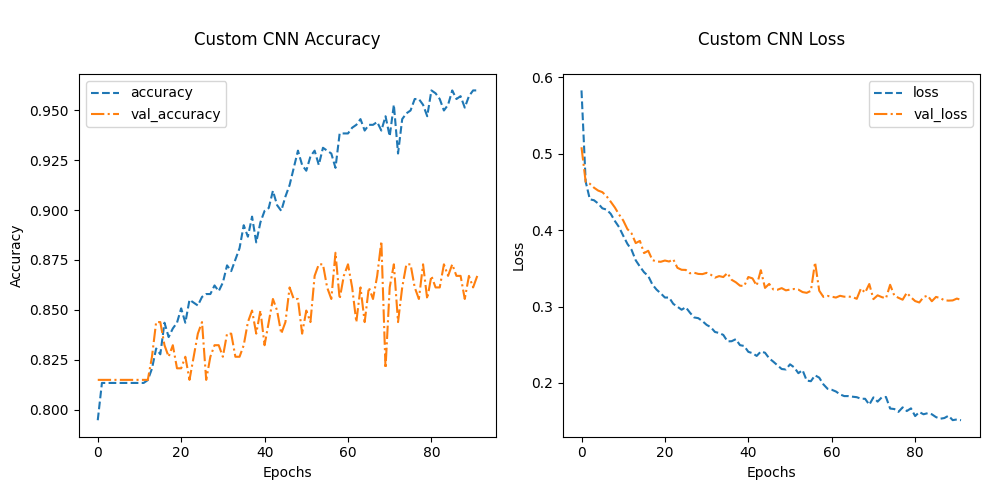

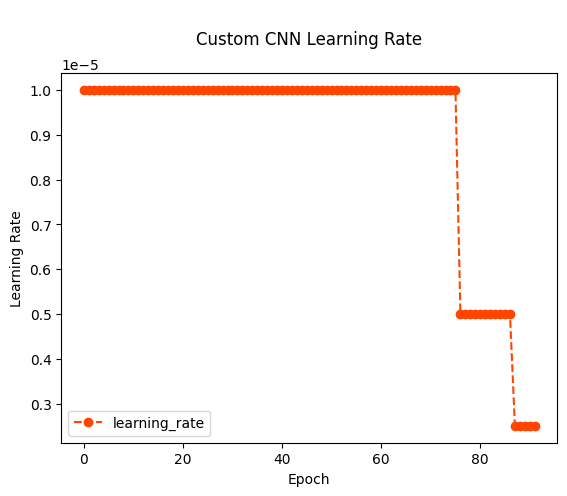

time: 803 ms (started: 2024-08-06 12:04:08 +00:00)


In [35]:
try:
    History(cnn_history, model_name='Custom CNN').plot_accuracy_and_lost()
    History(cnn_history, model_name='Custom CNN').plot_learningrate()
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

In [36]:
try:
    history_df = history_to_dataframe(cnn_history, 'custom_CNN')
    history_df
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

Validation Loss Terendah: 0.3053 pada Epoch: 82
Training Loss Terendah: 0.1511 pada Epoch: 92
Validation Accuracy Tertinggi: 0.8844 pada Epoch: 69
Training Accuracy Tertinggi: 0.9598 pada Epoch: 81
time: 9.25 ms (started: 2024-08-06 12:04:09 +00:00)


## 7.2. VGG-19

In [37]:
CALLBACKS = callbacks_list(
    monitor=Config.MONITOR,
    model_save_pathname='vgg19_best_model.keras',
    early_stopping_patience=Config.ES_PATIENCE,
    learning_rate_patience=Config.LR_PATIENCE,
    learning_rate_scheme=Config.LR_SCHEME
)

vgg19_history = train_model_with_callbacks(
    model=vgg19_model,
    training_set=train_set,
    validation_set=valid_set,
    epochs=Config.EPOCH,
    batch_size=Config.BATCH_SIZE,
    verbose='auto',
    callbacks=CALLBACKS,
)

		START TRAINING

Epoch 1/1000


2024-08-06 12:04:29.630846: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65536: 3.31777, expected 2.61172
2024-08-06 12:04:29.630912: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65537: 5.10329, expected 4.39724
2024-08-06 12:04:29.630922: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65538: 4.80913, expected 4.10308
2024-08-06 12:04:29.630930: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65544: 5.33366, expected 4.62762
2024-08-06 12:04:29.630937: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65545: 5.00267, expected 4.29663
2024-08-06 12:04:29.630945: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65546: 4.93559, expected 4.22954
2024-08-06 12:04:29.630953: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65547: 5.39283, expected 4.68678
2024-08-06 12:04:29.630960:

20/22 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step - accuracy: 0.6596 - loss: 0.5962

2024-08-06 12:05:36.409937: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 2.60208, expected 1.63992
2024-08-06 12:05:36.410003: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 4.92888, expected 3.96672
2024-08-06 12:05:36.410012: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 2: 4.46666, expected 3.5045
2024-08-06 12:05:36.410020: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 5.4528, expected 4.49063
2024-08-06 12:05:36.410028: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 5.93896, expected 4.97679
2024-08-06 12:05:36.410036: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 5: 6.09801, expected 5.13585
2024-08-06 12:05:36.410044: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 5.72988, expected 4.76772
2024-08-06 12:05:36.410051: E external/local_xla/xla/serv

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6697 - loss: 0.5887

2024-08-06 12:06:19.908430: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65536: 2.878, expected 2.23404
2024-08-06 12:06:19.908494: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65537: 3.5568, expected 2.91284
2024-08-06 12:06:19.908504: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65538: 3.30496, expected 2.661
2024-08-06 12:06:19.908512: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65539: 5.08961, expected 4.44565
2024-08-06 12:06:19.908519: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65540: 5.07424, expected 4.43028
2024-08-06 12:06:19.908527: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65541: 4.1956, expected 3.55164
2024-08-06 12:06:19.908535: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65542: 5.24525, expected 4.60129
2024-08-06 12:06:19.908543: E ext


Epoch 1: val_loss improved from inf to 0.47460, saving model to vgg19_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 139s 4s/step - accuracy: 0.6742 - loss: 0.5853 - val_accuracy: 0.8150 - val_loss: 0.4746 - learning_rate: 1.0000e-05
Epoch 2/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 975ms/step - accuracy: 0.8119 - loss: 0.4570
Epoch 2: val_loss improved from 0.47460 to 0.46445, saving model to vgg19_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 38s 1s/step - accuracy: 0.8120 - loss: 0.4577 - val_accuracy: 0.8150 - val_loss: 0.4644 - learning_rate: 1.0000e-05
Epoch 3/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8138 - loss: 0.4305
Epoch 3: val_loss improved from 0.46445 to 0.40667, saving model to vgg19_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 38s 1s/step - accuracy: 0.8138 - loss: 0.4296 - val_accuracy: 0.8150 - val_loss: 0.4067 - learning_rate: 1.0000e-05
Epoch 4/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8202 - loss: 0.3342
Epoch 4: val_loss improved from 0.40667 to

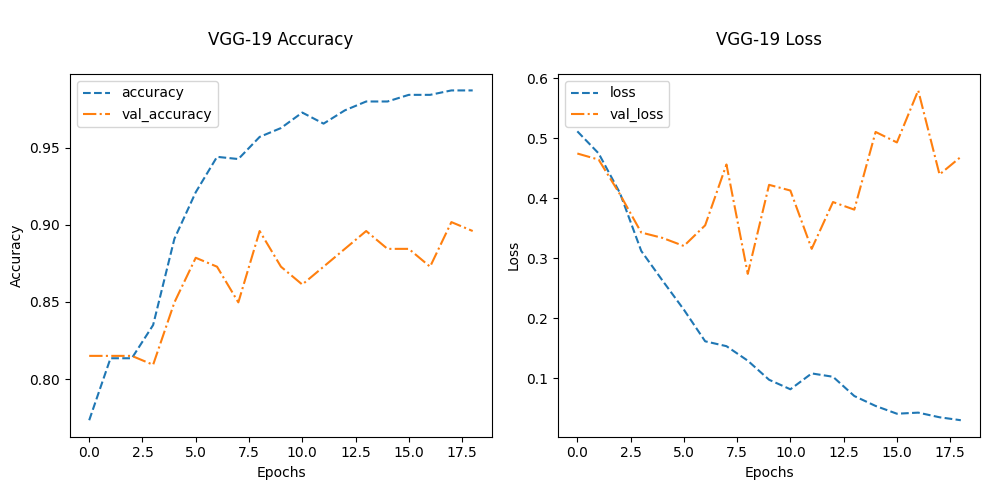

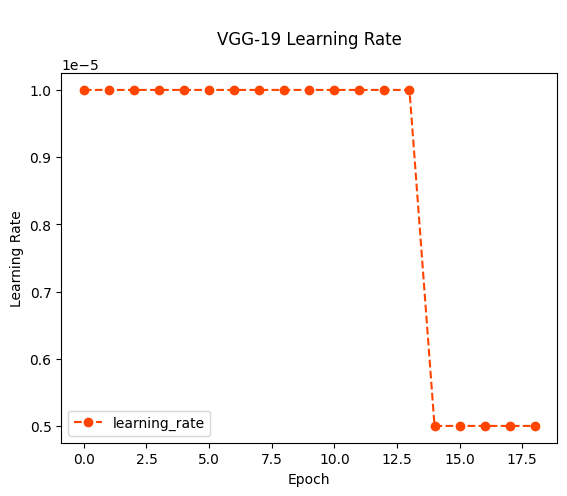

time: 885 ms (started: 2024-08-06 12:17:44 +00:00)


In [38]:
try:
    History(vgg19_history, model_name='VGG-19').plot_accuracy_and_lost()
    History(vgg19_history, model_name='VGG-19').plot_learningrate()
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

In [39]:
try:
    history_df = history_to_dataframe(vgg19_history, 'vgg19')
    history_df
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

Validation Loss Terendah: 0.2741 pada Epoch: 9
Training Loss Terendah: 0.0302 pada Epoch: 19
Validation Accuracy Tertinggi: 0.9017 pada Epoch: 18
Training Accuracy Tertinggi: 0.9871 pada Epoch: 18
time: 5.36 ms (started: 2024-08-06 12:17:45 +00:00)


## 7.3. EfficientNetV2B2

In [40]:
CALLBACKS = callbacks_list(
    monitor=Config.MONITOR,
    model_save_pathname='efficientnetv2b2_best_model.keras',
    early_stopping_patience=Config.ES_PATIENCE,
    learning_rate_patience=Config.LR_PATIENCE,
    learning_rate_scheme=Config.LR_SCHEME
)

efficientnetv2b2_history = train_model_with_callbacks(
    model=efficientnetv2b2_model,
    training_set=train_set,
    validation_set=valid_set,
    epochs=Config.EPOCH,
    batch_size=Config.BATCH_SIZE,
    verbose='auto',
    callbacks=CALLBACKS,
)

		START TRAINING

Epoch 1/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.1923 - loss: 0.8696   
Epoch 1: val_loss improved from inf to 0.95172, saving model to efficientnetv2b2_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 307s 7s/step - accuracy: 0.1948 - loss: 0.8675 - val_accuracy: 0.1850 - val_loss: 0.9517 - learning_rate: 1.0000e-05
Epoch 2/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 965ms/step - accuracy: 0.4386 - loss: 0.7228
Epoch 2: val_loss did not improve from 0.95172
22/22 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.4414 - loss: 0.7215 - val_accuracy: 0.1850 - val_loss: 1.0010 - learning_rate: 1.0000e-05
Epoch 3/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 969ms/step - accuracy: 0.6563 - loss: 0.6240
Epoch 3: val_loss improved from 0.95172 to 0.72666, saving model to efficientnetv2b2_best_model.keras
22/22 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - accuracy: 0.6589 - loss: 0.6226 - val_accuracy: 0.5145 - val_loss: 0.7267 - learning_rate: 1.0000e-05
Epoch 4/1000
22/22 ━━━━━━━━━━━━━━━━━━━━ 0

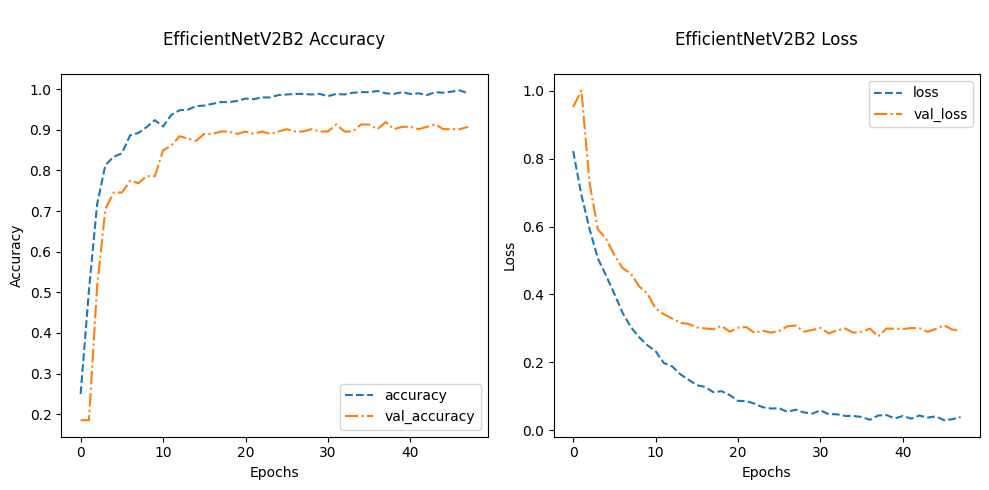

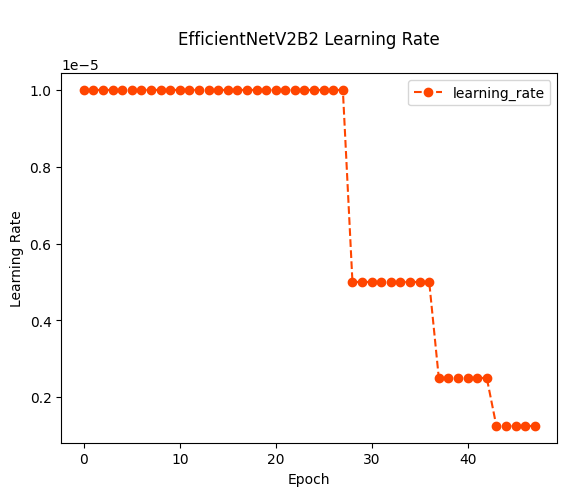

time: 675 ms (started: 2024-08-06 12:50:20 +00:00)


In [41]:
try:
    History(efficientnetv2b2_history, model_name='EfficientNetV2B2').plot_accuracy_and_lost()
    History(efficientnetv2b2_history, model_name='EfficientNetV2B2').plot_learningrate()
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

In [42]:
try:
    history_df = history_to_dataframe(efficientnetv2b2_history, 'efficientnetv2b2')
    history_df
except AttributeError:
    print("\nKesalahan: History training tidak ada!\n")

Validation Loss Terendah: 0.2763 pada Epoch: 38
Training Loss Terendah: 0.0296 pada Epoch: 46
Validation Accuracy Tertinggi: 0.9191 pada Epoch: 38
Training Accuracy Tertinggi: 0.9971 pada Epoch: 47
time: 6.1 ms (started: 2024-08-06 12:50:21 +00:00)


# 8. Evaluate

## 8.1. Custom CNN

/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


6/7 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step

2024-08-06 12:50:56.615262: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 6.16963, expected 5.41021
2024-08-06 12:50:56.615325: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 6.17944, expected 5.42002
2024-08-06 12:50:56.615341: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 20: 5.33829, expected 4.57887
2024-08-06 12:50:56.615364: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 30: 6.5212, expected 5.76178
2024-08-06 12:50:56.615378: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 31: 4.53269, expected 3.77327
2024-08-06 12:50:56.615389: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 38: 6.35237, expected 5.59295
2024-08-06 12:50:56.615400: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 40: 6.33219, expected 5.57277
2024-08-06 12:50:56.615411: E external/local_xla/xl

7/7 ━━━━━━━━━━━━━━━━━━━━ 30s 4s/step
Custom CNN Classification Report
              precision    recall  f1-score   support

        Asli       0.93      0.61      0.74       165
       Palsu       0.41      0.87      0.56        53

    accuracy                           0.67       218
   macro avg       0.67      0.74      0.65       218
weighted avg       0.81      0.67      0.69       218



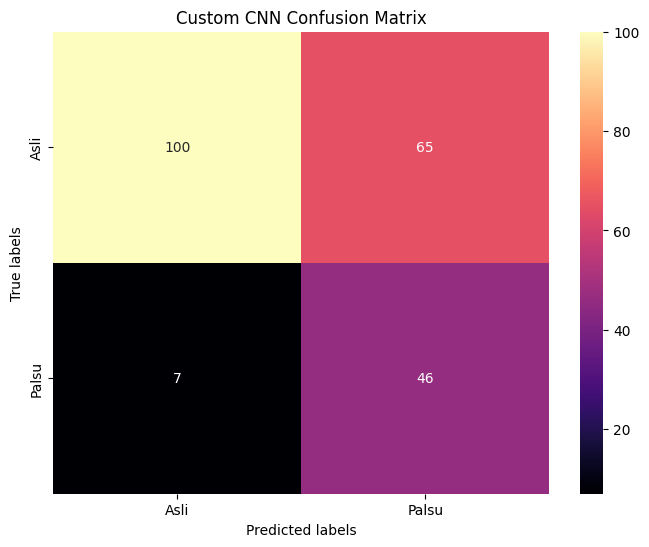

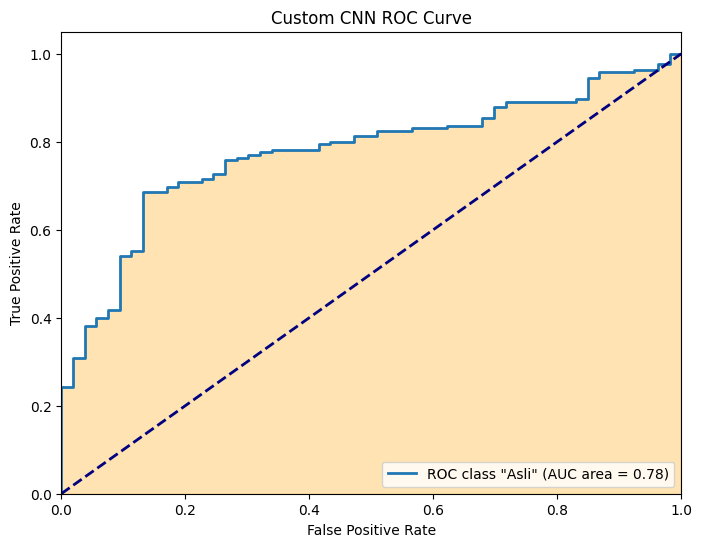

time: 37.7 s (started: 2024-08-06 12:50:21 +00:00)


In [43]:
try:
    cnn_best_model = load_model('cnn_best_model.keras')
    cnn_evaluator = ModelEvaluation(cnn_best_model, test_set, model_name='Custom CNN')

    cnn_y_true, cnn_y_pred = cnn_evaluator.predict_test()
    
    cnn_evaluator.classification_report()
    cnn_evaluator.plot_confusion_matrix()
    cnn_evaluator.plot_roc_auc()
except OSError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')
except ValueError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')

## 8.2. VGG-19

6/7 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step

2024-08-06 12:51:29.370339: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 65715: 3.0157, expected 2.60987
2024-08-06 12:51:29.370748: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 131015: 2.86642, expected 2.46059
2024-08-06 12:51:29.371235: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 196608: 2.23096, expected 1.76465
2024-08-06 12:51:29.371273: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 196609: 3.31516, expected 2.84885
2024-08-06 12:51:29.371282: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 196610: 3.24272, expected 2.77641
2024-08-06 12:51:29.371294: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 196616: 3.59784, expected 3.13153
2024-08-06 12:51:29.371308: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 196629: 3.41196, expected 2.94565
2024-08-06 12:51:29.37

7/7 ━━━━━━━━━━━━━━━━━━━━ 40s 6s/step
VGG-19 Classification Report
              precision    recall  f1-score   support

        Asli       0.76      0.98      0.86       165
       Palsu       0.40      0.04      0.07        53

    accuracy                           0.75       218
   macro avg       0.58      0.51      0.46       218
weighted avg       0.67      0.75      0.67       218



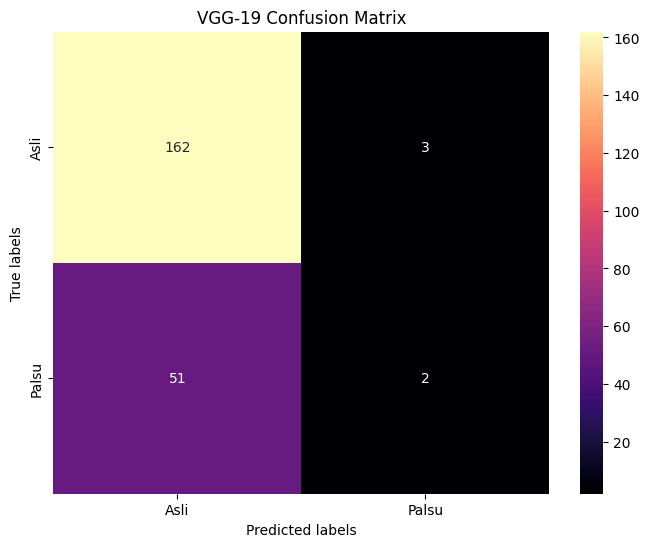

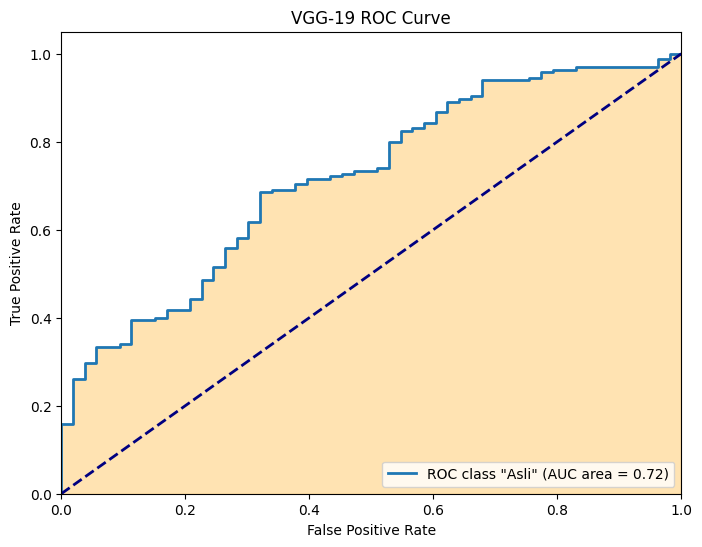

time: 47.1 s (started: 2024-08-06 12:50:59 +00:00)


In [44]:
try:
    vgg19_best_model = load_model('vgg19_best_model.keras')
    vgg19_evaluator = ModelEvaluation(vgg19_best_model, test_set, model_name='VGG-19')

    vgg19_y_true, vgg19_y_pred = vgg19_evaluator.predict_test()
    
    vgg19_evaluator.classification_report()
    vgg19_evaluator.plot_confusion_matrix()
    vgg19_evaluator.plot_roc_auc()
except OSError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')
except ValueError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')

## 8.3. EfficientNetV2B2

7/7 ━━━━━━━━━━━━━━━━━━━━ 35s 4s/step
EfficientNetV2B2 Classification Report
              precision    recall  f1-score   support

        Asli       0.94      0.87      0.90       165
       Palsu       0.67      0.81      0.74        53

    accuracy                           0.86       218
   macro avg       0.80      0.84      0.82       218
weighted avg       0.87      0.86      0.86       218



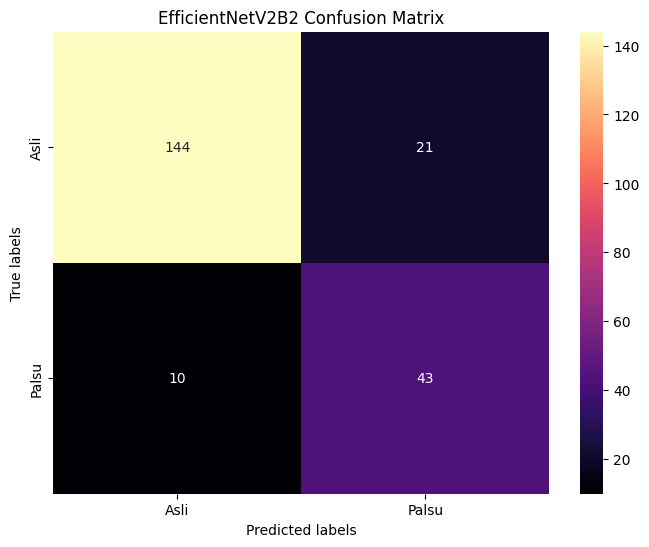

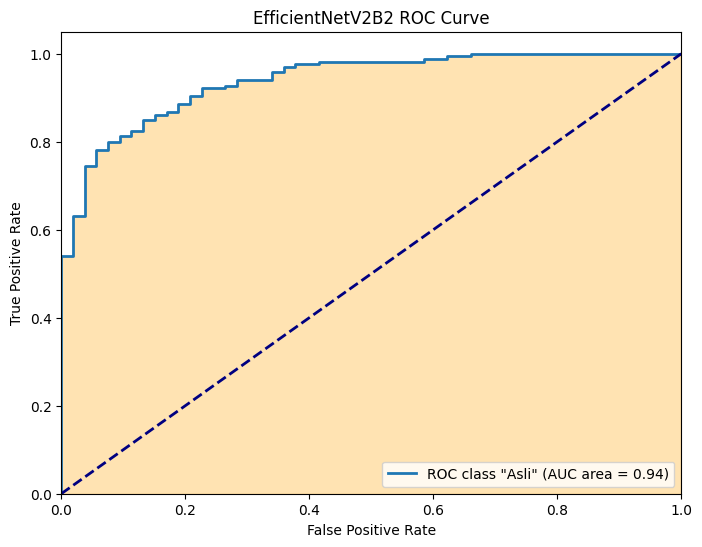

time: 44.7 s (started: 2024-08-06 12:51:46 +00:00)


In [45]:
try:
    efficientnetv2b2_best_model = load_model('efficientnetv2b2_best_model.keras')
    efficientnetv2b2_evaluator = ModelEvaluation(efficientnetv2b2_best_model, test_set, model_name='EfficientNetV2B2')

    efficientnetv2b2_y_true, efficientnetv2b2_y_pred = efficientnetv2b2_evaluator.predict_test()
    
    efficientnetv2b2_evaluator.classification_report()
    efficientnetv2b2_evaluator.plot_confusion_matrix()
    efficientnetv2b2_evaluator.plot_roc_auc()
except OSError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')
except ValueError as e:
    print(f'Kesalahan: {e} (Tidak ada model yang tersimpan) !!!')

# 9. Hyperparameter Tuning for Best Model (Using Optuna)

In [46]:
# # Define the model
# def create_model(trial):
#   # Get the EfficientNetV2B base model
#   base_model = EfficientNetV2B(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
#   base_model.trainable = False  # Freeze the base model weights

#   # Add custom layers for classification
#   x = GlobalAveragePooling2D()(base_model.output)
#   x = Dense(trial.suggest_int('units', 16, 512), activation='relu')(x)
#   outputs = Dense(10, activation='softmax')(x)

#   model = tf.keras.Model(inputs=base_model.input, outputs=outputs)

#   # Define optimizer based on trial suggestion
#   optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'SGD', 'RMSprop', 'AdamW'])
#   if optimizer_name == 'Adam':
#     optimizer = Adam(learning_rate=trial.suggest_float('learning_rate', 1e-5, 1e-3))
#   elif optimizer_name == 'SGD':
#     optimizer = SGD(learning_rate=trial.suggest_float('learning_rate', 1e-4, 1e-1), momentum=trial.suggest_float('momentum', 0.0, 1.0))
#   elif optimizer_name == 'RMSprop':
#     optimizer = RMSprop(learning_rate=trial.suggest_float('learning_rate', 1e-4, 1e-1))
#   elif optimizer_name == 'AdamW':
#     optimizer = AdamW(learning_rate=trial.suggest_float('learning_rate', 1e-5, 1e-3))

#   # Compile the model
#   model.compile(optimizer=optimizer,
#                 loss='categorical_crossentropy', metrics=['accuracy'], callbacks=[reduce_lr, early_stop, model_checkpoint])

#   return model

# # Define the objective function
# def objective(trial):
#   # Create the model with trial parameters
#   model = create_model(trial)

#   # Load and train the model on your dataset (replace with your actual data)
#   # ...

#   # Evaluate the model's accuracy
#   accuracy = model.evaluate(x_test, y_test)['accuracy']

#   # Return the accuracy as the objective value
#   return accuracy

# # Create the Optuna study
# study = optuna.create_study(direction='maximize')

# # Start the optimization
# study.optimize(objective, n_trials=100)  # Set the number of trials as desired

# # Get the best trial
# best_trial = study.best_trial

# # Print the best parameters and accuracy
# print("Best parameters:")
# print("  optimizer:", best_trial.params['optimizer'])
# print("  units:", best_trial.params['units'])
# print("  learning_rate:", best_trial.params['learning_rate'])
# if best_trial.params['optimizer'] in ['SGD', 'RMSprop']:
#   print("  momentum:", best_trial.params.get('momentum'))
# print("Best accuracy:", best_trial.value)

time: 1.45 ms (started: 2024-08-06 12:52:30 +00:00)


# 10. Visualizing with Grad-CAM

"Gradient-weighted Class Activation Mapping (Grad-CAM), uses the gradients of any target concept (say 'dog' in a classification network or a sequence of words in captioning network) flowing into the final convolutional layer to produce a coarse localization map highlighting the important regions in the image for predicting the concept." **- Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization** (Ramprasaath R. Selvaraju, Michael Cogswell, Abhishek Das, Ramakrishna Vedantam, Devi Parikh, Dhruv Batra)

- Derivative of the class with the highest probability returned by the softmax layer is taken with respect to the final convolutional layer to produce a heat map which highlights the important regions in the image that activated the class.
- For full mathematical details please check out this paper: https://arxiv.org/abs/1610.02391

In [47]:
GradCAM_config = {
    'model_list' : {
        'custom_cnn' : cnn_model,
        'vgg19' : vgg19_model,
        'efficientnetv2b2' : efficientnetv2b2_model,
    },
    'last_conv_layer' : {
        'custom_cnn' : -5, # conv2d_4 (Conv2D)
        'vgg19' : -5, # block5_conv4 (Conv2D)
        'efficientnetv2b2' : -6, # top_conv (Conv2D)
    },
    'y_true' : {
        'custom_cnn' : cnn_y_true,
        'vgg19' : vgg19_y_true,
        'efficientnetv2b2' : efficientnetv2b2_y_true,
    },
    'y_pred' : {
        'custom_cnn' : cnn_y_pred,
        'vgg19' : vgg19_y_pred,
        'efficientnetv2b2' : efficientnetv2b2_y_pred,
    },
    'prob_threshold' : 0.75,
}

time: 10.8 ms (started: 2024-08-06 12:52:30 +00:00)


In [48]:
model = GradCAM_config['model_list']['efficientnetv2b2']
last_conv_layer = GradCAM_config['last_conv_layer']['efficientnetv2b2']
y_true = GradCAM_config['y_true']['efficientnetv2b2']
y_pred = GradCAM_config['y_pred']['efficientnetv2b2']
model.layers[last_conv_layer].output

<KerasTensor shape=(None, 8, 8, 1408), dtype=float32, sparse=False, name=keras_tensor_477>

time: 12.8 ms (started: 2024-08-06 12:52:31 +00:00)


In [49]:
y_val = y_true
y_pred = y_pred
y_pred_classes = np.argmax(y_pred, axis=1)
y_pred_probs = np.max(y_pred, axis=1)

class_indices = test_set.class_indices
indices = {v:k for k,v in class_indices.items()}

filenames = test_set.filenames

val_df = pd.DataFrame()
val_df['filename'] = filenames
val_df['actual'] = y_val
val_df['predicted'] = y_pred_classes
val_df['probability'] = y_pred_probs
val_df['actual'] = val_df['actual'].apply(lambda x: indices[x])
val_df['predicted'] = val_df['predicted'].apply(lambda x: indices[x])
val_df.loc[val_df['actual']==val_df['predicted'],'Same'] = True
val_df.loc[val_df['actual']!=val_df['predicted'],'Same'] = False
val_df.head(10)

,filename,actual,predicted,probability,Same
0,Asli/IMG_3422.jpg,Asli,Asli,0.982023,True
1,Asli/IMG_3423.jpg,Asli,Asli,0.977418,True
2,Asli/IMG_3516.jpg,Asli,Asli,0.673070,True
3,Asli/IMG_3517.jpg,Asli,Asli,0.799917,True
4,Asli/IMG_3518.jpg,Asli,Asli,0.983940,True
5,Asli/IMG_3519.jpg,Asli,Asli,0.975277,True
6,Asli/IMG_3520.jpg,Asli,Asli,0.996981,True
7,Asli/IMG_3521.jpg,Asli,Asli,0.811644,True
8,Asli/IMG_3522.jpg,Asli,Asli,0.959711,True
9,Asli/IMG_3523.jpg,Asli,Palsu,0.727287,False


time: 26.1 ms (started: 2024-08-06 12:52:31 +00:00)


In [50]:
val_df.describe().T

,count,mean,std,min,25%,50%,75%,max
probability,218.0,0.854875,0.145938,0.50086,0.760649,0.913878,0.976237,0.999841


time: 12.9 ms (started: 2024-08-06 12:52:31 +00:00)


In [51]:
number_of_correct_classfied = len(val_df[val_df['Same'] == True])
number_of_correct_classfied_asli = len(val_df[(val_df['Same'] == True) & (val_df['actual'] == 'Asli')])
number_of_correct_classfied_palsu = len(val_df[(val_df['Same'] == True) & (val_df['actual'] == 'Palsu')])
number_of_misclassfied = len(val_df[val_df['Same'] == False])
number_of_misclassfied_asli = len(val_df[(val_df['Same'] == False) & (val_df['actual'] == 'Asli')])
number_of_misclassfied_palsu = len(val_df[(val_df['Same'] == False) & (val_df['actual'] == 'Palsu')])
val_df = val_df.sample(frac=1).reset_index(drop=True)

time: 9.44 ms (started: 2024-08-06 12:52:31 +00:00)


### Image Visualization
- Correctly Classified (A and P are same)
- Misclassified (A and P are different)
- A: Actual P: Predicted

In [52]:
def readImage(path):
    img = load_img(path,color_mode=Config.COLOR_MODE,target_size=(Config.IMAGE_SIZE,Config.IMAGE_SIZE))
    img = img_to_array(img)
    img = img/255.

    return img

def display_images(temp_df, image_range=1):
    temp_df = temp_df.reset_index(drop=True)
    plt.figure(figsize=(20, 20))
    n = 0
    for i in range(image_range):
        n += 1
        plt.subplot(5, 5, n)
        plt.subplots_adjust(hspace=0.5, wspace=0.3)
        image = readImage(f"{test_set_dir}/{temp_df.filename[i]}")
        if temp_df['Same'][i]:
            if temp_df.probability[i] < GradCAM_config['prob_threshold']:
                title_color = 'orange'
            else:
                title_color = 'green'
        else:
            if temp_df.probability[i] < GradCAM_config['prob_threshold']:
                title_color = 'orange'
            else:
                title_color = 'red'
        plt.imshow(image)
        plt.title(f'\n{temp_df.filename[i]}\nA: {temp_df.actual[i]} <> P: {temp_df.predicted[i]}\n[Prob: {temp_df.probability[i]:.2f}]', color=title_color)


time: 5.14 ms (started: 2024-08-06 12:52:31 +00:00)


### Number of Predictions and Visualized

In [53]:
print(f'TOTAL prediksi BENAR : {number_of_correct_classfied}')
print(f'Jumlah prediksi benar ASLI  : {number_of_correct_classfied_asli}')
print(f'Jumlah prediksi benar PALSU : {number_of_correct_classfied_palsu}')
print('-'*50)
print(f'TOTAL prediksi SALAH : {number_of_misclassfied}')
print(f'Jumlah prediksi salah ASLI  : {number_of_misclassfied_asli}')
print(f'Jumlah prediksi salah PALSU : {number_of_misclassfied_palsu}')

TOTAL prediksi BENAR : 187
Jumlah prediksi benar ASLI  : 144
Jumlah prediksi benar PALSU : 43
--------------------------------------------------
TOTAL prediksi SALAH : 31
Jumlah prediksi salah ASLI  : 21
Jumlah prediksi salah PALSU : 10
time: 5.99 ms (started: 2024-08-06 12:52:31 +00:00)


In [54]:
if number_of_correct_classfied_asli < 25:
    num_of_correct_visualizations_asli = number_of_correct_classfied_asli
else:
    num_of_correct_visualizations_asli = 25
    
if number_of_correct_classfied_palsu < 25:
    num_of_correct_visualizations_palsu = number_of_correct_classfied_palsu
else:
    num_of_correct_visualizations_palsu = 25
    
if number_of_misclassfied_asli < 25:
    num_of_incorrect_visualizations_asli = number_of_misclassfied_asli
else:
    num_of_incorrect_visualizations_asli = 25
    
if number_of_misclassfied_palsu < 25:
    num_of_incorrect_visualizations_palsu = number_of_misclassfied_palsu
else:
    num_of_incorrect_visualizations_palsu = 25
    
num_of_correct_visualizations_asli, num_of_correct_visualizations_palsu, num_of_incorrect_visualizations_asli, num_of_incorrect_visualizations_palsu

(25, 25, 21, 10)

time: 11.1 ms (started: 2024-08-06 12:52:31 +00:00)


### Correctly Classified

#### Asli

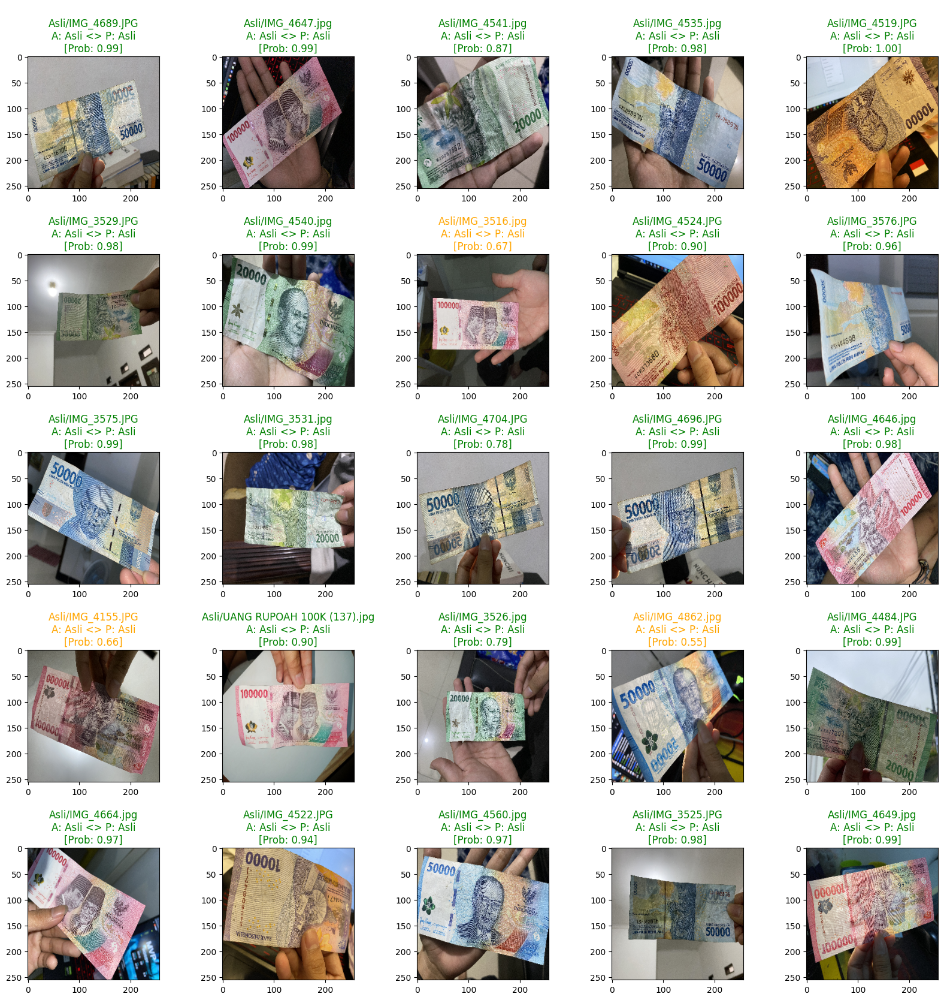

time: 8.52 s (started: 2024-08-06 12:52:31 +00:00)


In [55]:
display_images(val_df[(val_df['Same'] == True) & (val_df['actual'] == 'Asli')], image_range=num_of_correct_visualizations_asli)

#### Palsu

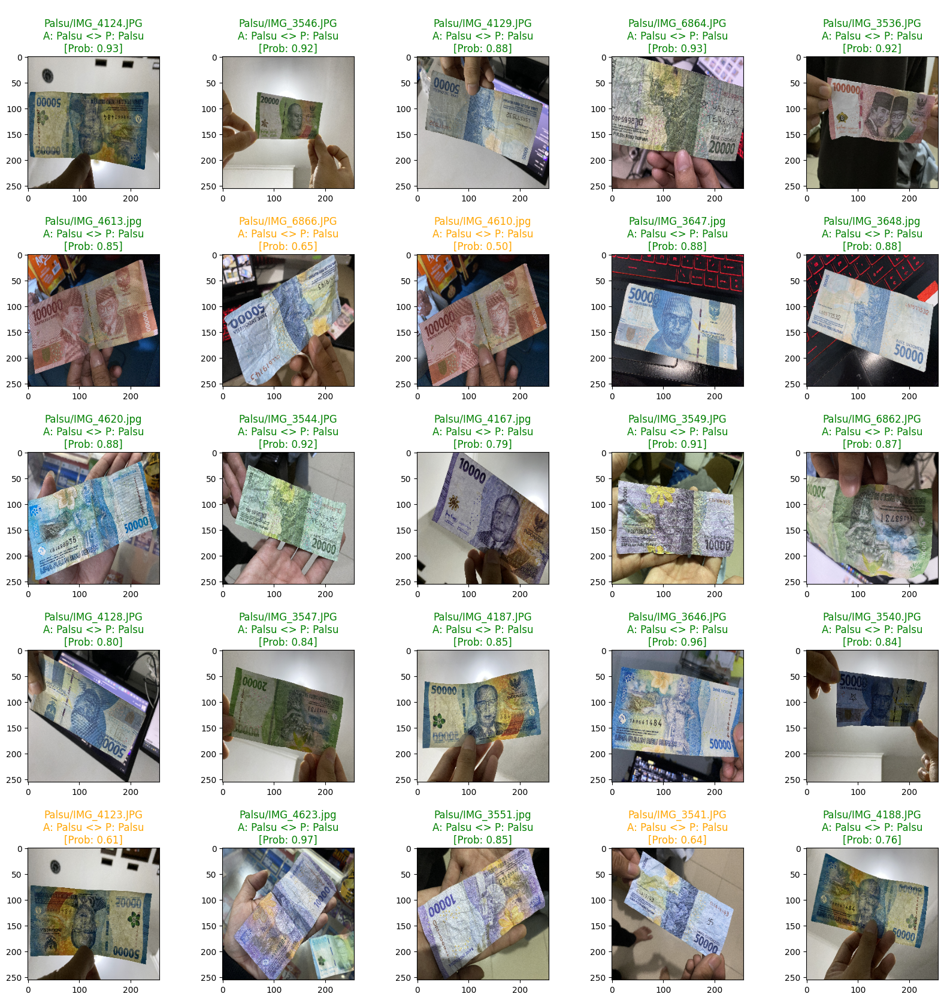

time: 7.46 s (started: 2024-08-06 12:52:39 +00:00)


In [56]:
display_images(val_df[(val_df['Same'] == True) & (val_df['actual'] == 'Palsu')], image_range=num_of_correct_visualizations_palsu)

### Misclassified

#### Asli

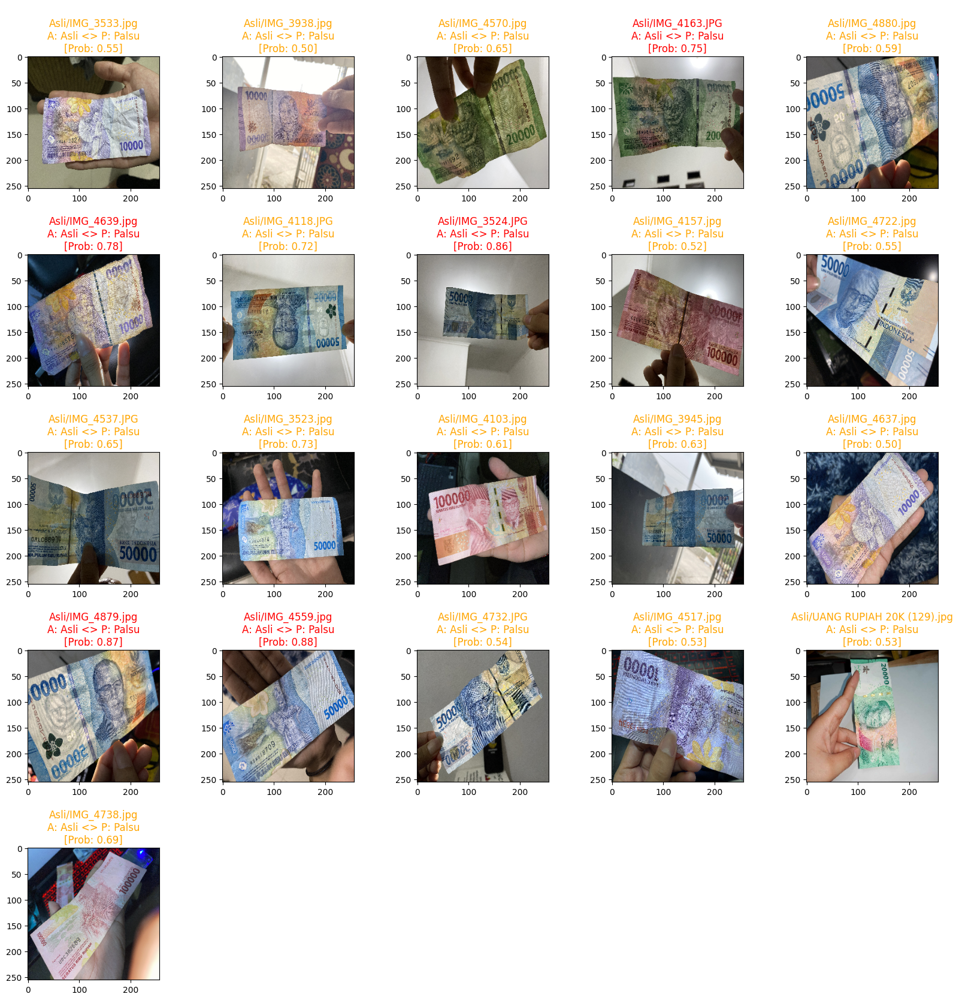

time: 6.28 s (started: 2024-08-06 12:52:47 +00:00)


In [57]:
display_images(val_df[(val_df['Same'] == False) & (val_df['actual'] == 'Asli')], image_range=num_of_incorrect_visualizations_asli)

#### Palsu

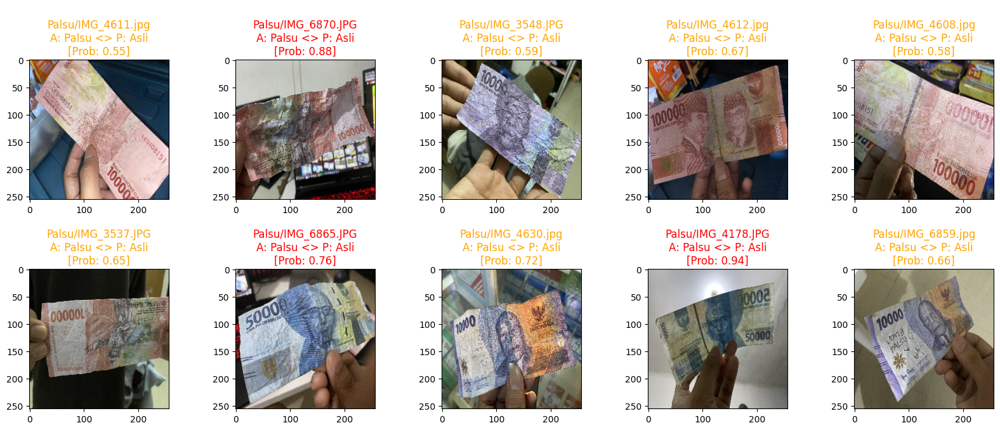

time: 3.16 s (started: 2024-08-06 12:52:53 +00:00)


In [58]:
display_images(val_df[(val_df['Same'] == False) & (val_df['actual'] == 'Palsu')], image_range=num_of_incorrect_visualizations_palsu)

### Grad-CAM Computation
- Gradient computed of the final softmax layer with respect to the last convolution layer
- Mean of the gradients is then multiplied to the last convolution layer's output
- The output is then passed through a relu function to ensure that all values are positive

In [59]:
def make_gradcam_heatmap(img_array, model, last_conv_layer=-3,  pred_index=None, ):

    grad_model = Model(inputs=model.inputs, outputs=[model.layers[last_conv_layer].output, model.output])

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy(), preds

time: 1.25 ms (started: 2024-08-06 12:52:56 +00:00)


### Grad-CAM Projection
- The heatmap produced using the Grad-CAM computation is then projected on to the original image
- The heatmap highlights the important parts of the image that lead to the activation of a class in the final softmax layer

In [60]:
def gradCAMImage(image):
    path = f"{test_set_dir}/{image}"
    img = readImage(path)
    img = np.expand_dims(img,axis=0)
    heatmap,preds = make_gradcam_heatmap(img, model, last_conv_layer)

    img = load_img(path)
    img = img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * 0.8 + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    return superimposed_img

time: 5.86 ms (started: 2024-08-06 12:52:56 +00:00)


## Results

In [61]:
def gradcam_of_images(correct_class, class_name, image_range=1):
    grad_images = []
    title = []
#     temp_df = val_df[val_df['Same']==correct_class]
    temp_df = val_df[(val_df['Same'] == correct_class) & (val_df['actual'] == class_name)]
    temp_df = temp_df.reset_index(drop=True)
    for i in range(image_range):
        image = temp_df.filename[i]
        grad_image = gradCAMImage(image)
        grad_images.append(grad_image)
        if correct_class:
            if temp_df.probability[i] < GradCAM_config['prob_threshold']:
                title_color = 'orange'
            else:
                title_color = 'green'
        else:
            if temp_df.probability[i] < GradCAM_config['prob_threshold']:
                title_color = 'orange'
            else:
                title_color = 'red'
        title_text = f'\nA: {temp_df.actual[i]} <> P: {temp_df.predicted[i]}\n[Prob: {temp_df.probability[i]:.4f}]'
        title.append((title_text, title_color))

    return grad_images, title

time: 3.39 ms (started: 2024-08-06 12:52:56 +00:00)


### Correctly Classified

#### Asli

In [62]:
correctly_classified_asli, c_titles_asli = gradcam_of_images(correct_class=True, class_name='Asli', image_range=num_of_correct_visualizations_asli)

/tmp/ipykernel_34/274265248.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


time: 34.2 s (started: 2024-08-06 12:52:56 +00:00)


#### Palsu

In [63]:
correctly_classified_palsu, c_titles_palsu = gradcam_of_images(correct_class=True, class_name='Palsu', image_range=num_of_correct_visualizations_palsu)

/tmp/ipykernel_34/274265248.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


time: 33.7 s (started: 2024-08-06 12:53:30 +00:00)


### Misclassified

#### Asli

In [64]:
misclassified_asli, m_titles_asli = gradcam_of_images(correct_class=False, class_name='Asli', image_range=num_of_incorrect_visualizations_asli)

/tmp/ipykernel_34/274265248.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


time: 28.3 s (started: 2024-08-06 12:54:04 +00:00)


#### Palsu

In [65]:
misclassified_palsu, m_titles_palsu = gradcam_of_images(correct_class=False, class_name='Palsu', image_range=num_of_incorrect_visualizations_palsu)

/tmp/ipykernel_34/274265248.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


time: 15 s (started: 2024-08-06 12:54:32 +00:00)


## Display-Heatmaps

In [66]:
def display_heatmaps(classified_images, titles, image_range=1):
    plt.figure(figsize = (20, 20))
    n = 0
    for i in range(image_range):
        n+=1
        plt.subplot(5, 5, n)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        plt.imshow(classified_images[i])
        plt.title(titles[i][0], color=titles[i][1])
    plt.show()

time: 759 µs (started: 2024-08-06 12:54:47 +00:00)


### Grad-CAM: Correctly Classified

#### Asli

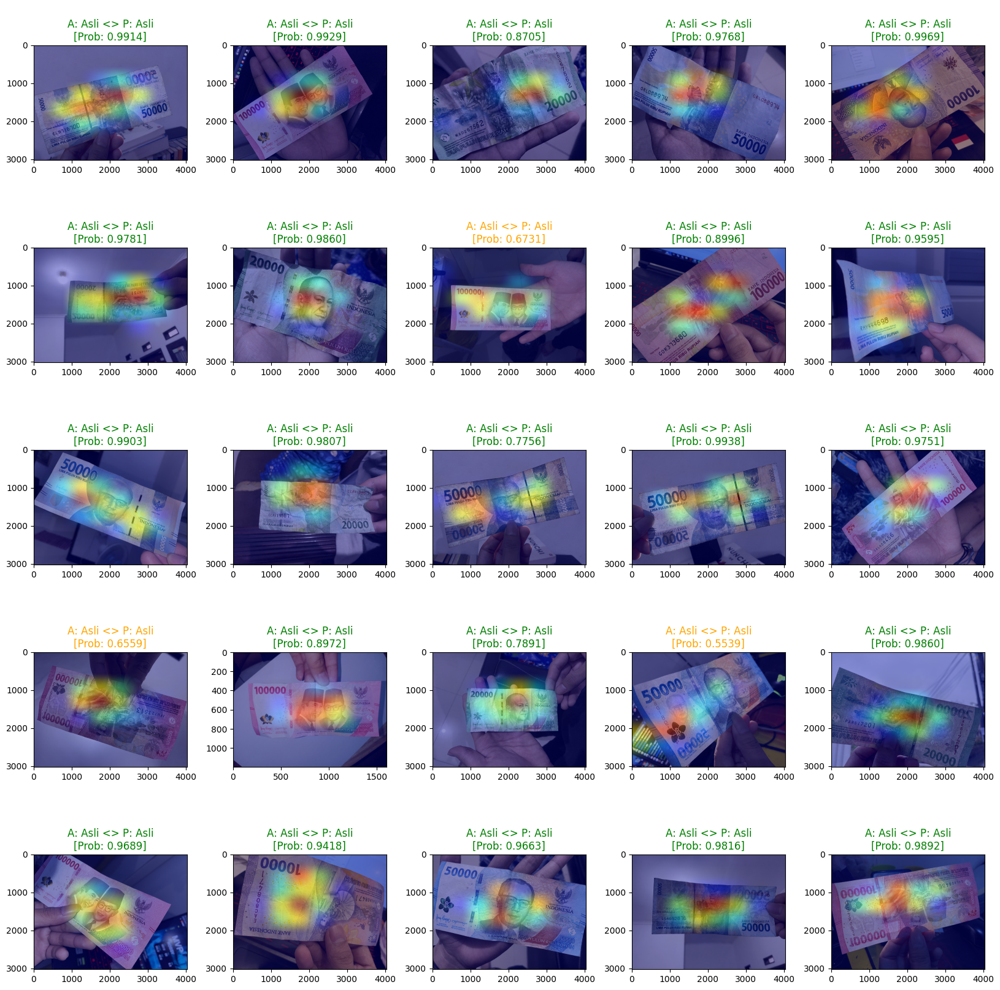

time: 35.2 s (started: 2024-08-06 12:54:47 +00:00)


In [67]:
display_heatmaps(classified_images=correctly_classified_asli, titles=c_titles_asli, image_range=num_of_correct_visualizations_asli)

#### Palsu

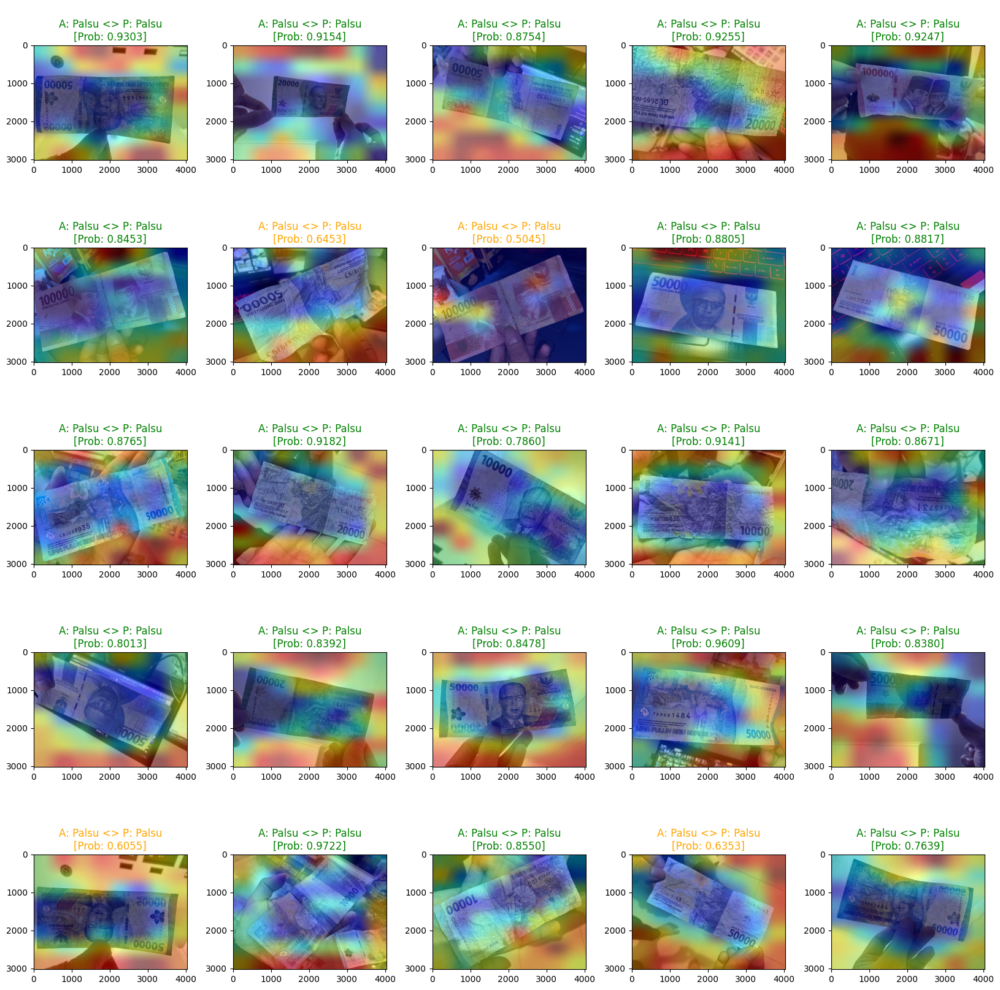

time: 36 s (started: 2024-08-06 12:55:23 +00:00)


In [68]:
display_heatmaps(classified_images=correctly_classified_palsu, titles=c_titles_palsu, image_range=num_of_correct_visualizations_palsu)

### Grad-CAM: Incorrectly Classified

#### Asli

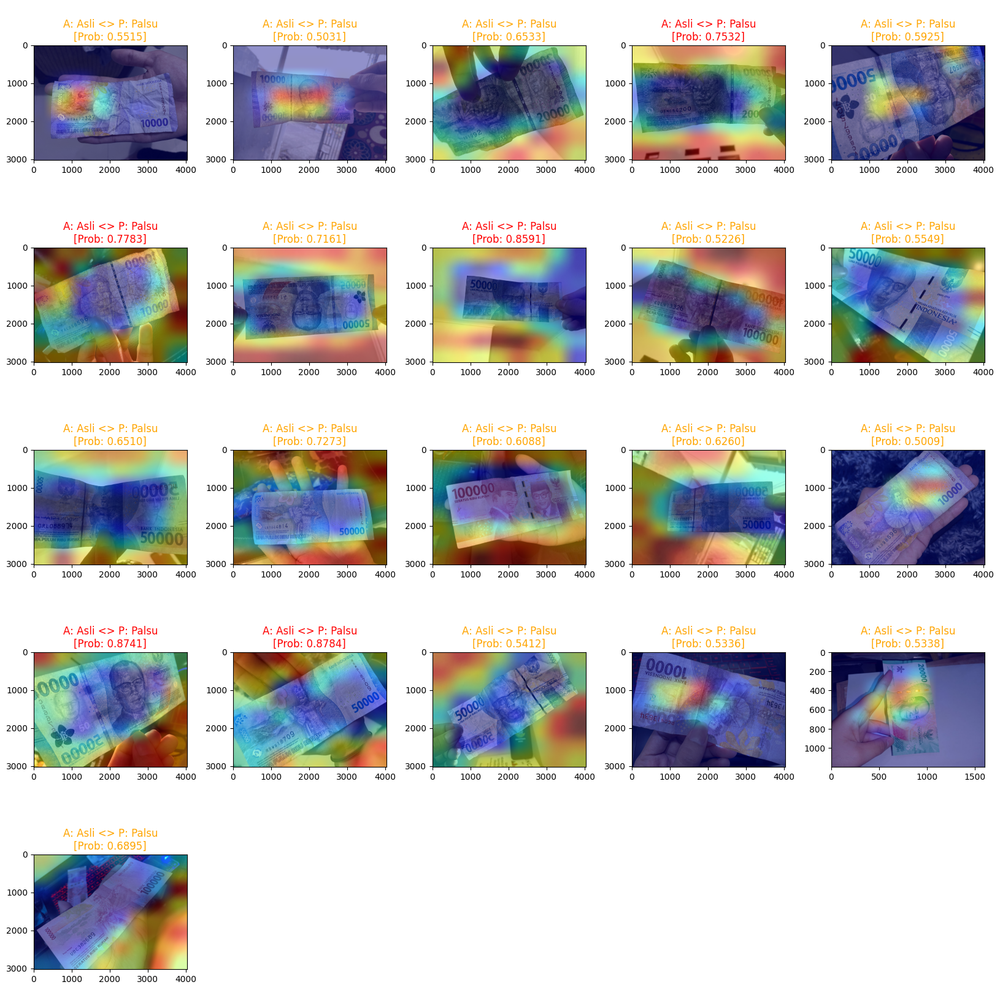

time: 29.3 s (started: 2024-08-06 12:55:59 +00:00)


In [69]:
display_heatmaps(classified_images=misclassified_asli, titles=m_titles_asli, image_range=num_of_incorrect_visualizations_asli)

#### Palsu

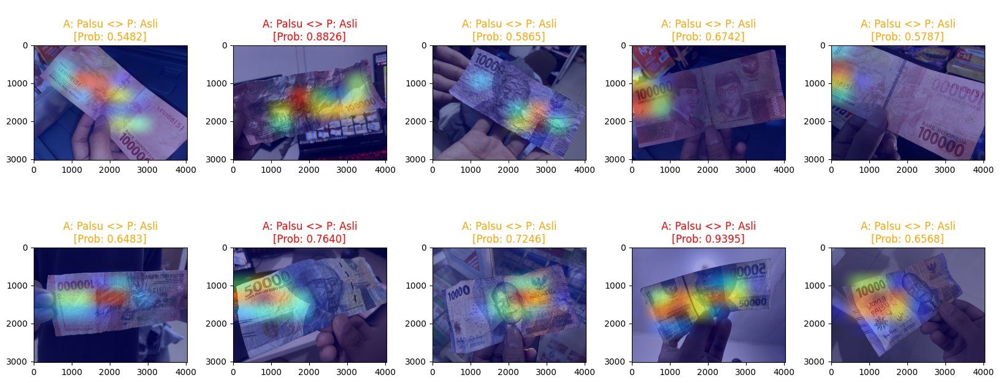

time: 14.7 s (started: 2024-08-06 12:56:28 +00:00)


In [70]:
display_heatmaps(classified_images=misclassified_palsu, titles=m_titles_palsu, image_range=num_of_incorrect_visualizations_palsu)

# 11. Model Deployment to Flutter

In [71]:
print(train_set.class_indices)
labels = '\n'.join(sorted(
    train_set.class_indices.keys()
))

with open('labels.txt', 'w') as f:    
    f.write(labels)

{'Asli': 0, 'Palsu': 1}
time: 1.81 ms (started: 2024-08-06 12:56:43 +00:00)


In [72]:
saved_model_dir = ''
tf.saved_model.save(model, saved_model_dir)

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
tflite_model = converter.convert()

with open('real_fake_rupiah.tflite', 'wb') as f:
    f.write(tflite_model)

Summary on the non-converted ops:
---------------------------------
 * Accepted dialects: tfl, builtin, func
 * Non-Converted Ops: 248, Total Ops 676, % non-converted = 36.69 %
 * 248 ARITH ops

- arith.constant:  248 occurrences  (f32: 239, i32: 9)



  (f32: 22)
  (f32: 96)
  (f32: 20)
  (f32: 2)
  (f32: 90)
  (f32: 21)
  (f32: 92)
  (i32: 20)
  (f32: 20)
  (i32: 20)
  (f32: 1)
  (i32: 20)
  (f32: 1)


time: 59.2 s (started: 2024-08-06 12:56:43 +00:00)
